In [1]:
%matplotlib inline

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import scanpy as sc
import seaborn as sns
from cnmf import cNMF
import os 
import sys
import pickle


from scsim2 import scsim2
from scsim2_diff_librarysize import SCsim_DiffScale

def process(a):
    sc.pp.highly_variable_genes(a, flavor='seurat_v3', n_top_genes=2000)
    a.raw = a.copy()
    sc.pp.normalize_per_cell(a, counts_per_cell_after=10000)
    a = a[:,a.var['highly_variable']]
    sc.pp.scale(a, zero_center=False)
    sc.pp.pca(a)
    sc.pl.pca_variance_ratio(a, log=True)
    sc.pp.neighbors(a, n_neighbors=10, n_pcs=12)
    sc.tl.umap(a)
    sc.pl.umap(a)
    return(a)


def process_log(a):
    sc.pp.filter_cells(a, min_counts=200)
    sc.pp.highly_variable_genes(a, flavor='seurat_v3', n_top_genes=2000)
    a.raw = a.copy()
    sc.pp.normalize_per_cell(a, counts_per_cell_after=10000)
    sc.pp.log1p(a)
    a = a[:,a.var['highly_variable']]
    sc.pp.scale(a, zero_center=False)
    sc.pp.pca(a)
    sc.pl.pca_variance_ratio(a, log=True)
    sc.pp.neighbors(a, n_neighbors=10, n_pcs=12)
    sc.tl.umap(a)
    sc.pl.umap(a)
    return(a)



def df_col_corr(X, Y):
    X_norm = X.subtract(X.mean(axis=0), axis=1)
    X_norm= X_norm.divide(X_norm.std(axis=0), axis=1)
    Y_norm = Y.subtract(Y.mean(axis=0), axis=1)
    Y_norm= Y_norm.divide(Y_norm.std(axis=0), axis=1)
    
    X_mask = np.ma.array(X_norm.values, mask=np.isnan(X_norm.values))
    Y_mask = np.ma.array(Y_norm.values, mask=np.isnan(Y_norm.values))
    R = np.ma.dot(X_mask.T, Y_mask) / (X.shape[0]-1)
    
    R = pd.DataFrame(R, index=X.columns, columns=Y.columns)
    return(R)

def get_assignment(true_usages, inferred_usages):
    '''Get a mapping to reorder columns of inferred usage matrix
    to best match the columns of true usage matrix to allow easier comparison'''
    R = {}
    mapping = {}
    avail = set(true_usages.columns) # Set of programs to match
    toassign = set(inferred_usages.columns) #Set of programs to assign

    for i in inferred_usages.columns:
        R[i] = true_usages.corrwith(inferred_usages[i])
    
    R = pd.DataFrame.from_dict(R)
    Runst = R.unstack().reset_index()
    Runst.columns = ['learned', 'truth', 'corr']
    Runst = Runst.sort_values(by='corr', ascending=False)
    
    for i in Runst.index:
        if (Runst.loc[i, 'truth'] in avail) and (Runst.loc[i, 'learned'] in toassign):
            mapping[Runst.loc[i, 'learned']] = Runst.loc[i, 'truth']
            avail = avail - set([Runst.loc[i, 'truth']])
            toassign = toassign - set([Runst.loc[i, 'learned']])      
        
    
        if len(toassign) == 0:
            break
            
    return(mapping, R)

def load_df_from_npz(filename):
    with np.load(filename, allow_pickle=True) as f:
        obj = pd.DataFrame(**f)
    return obj

def load_and_relabel(cobj, true_gep_means, K=11, ldthresh=0.07):
    res = {}
    hvgs = open(cobj.paths['nmf_genes_list']).read().split('\n')
    (usage, gene_scores_Z, gene_scores, top_genes) = cobj.load_results(K=K, density_threshold=ldthresh)
    gene_scores = gene_scores.T
    gene_scores_Z = gene_scores_Z.T
    tpm_stats = load_df_from_npz(cobj.paths['tpm_stats'])
    
    stds = tpm_stats['__std']
    true_gep_means_hvgs = true_gep_means.loc[:, hvgs]
        
    gene_scores_hvgs = gene_scores.loc[:, hvgs]
    true_gep_means_hvgs_norm = true_gep_means_hvgs.div(stds.loc[hvgs], axis=1)    
    
    gene_scores_hvgs_norm = gene_scores_hvgs.div(stds.loc[hvgs], axis=1)
    assignmap, R = get_assignment(true_gep_means_hvgs_norm.T,
                                  gene_scores_hvgs_norm.T)
    
    fig,ax = plt.subplots(1,1, figsize=(3,3), dpi=200)
    gene_scores_hvgs_norm_relabeled = gene_scores_hvgs_norm.rename(index=assignmap)
    #gene_scores_hvgs_norm_relabeled.index = [int(x.replace('True_', '')) for x in gene_scores_hvgs_norm_relabeled.index]
    gene_scores_hvgs_norm_relabeled = gene_scores_hvgs_norm_relabeled.sort_index(axis=0)       
    
    R = df_col_corr(true_gep_means_hvgs_norm.T, gene_scores_hvgs_norm_relabeled.T)
    ax = sns.heatmap(R.sort_index(axis=1).sort_index(axis=0))
    ax.set_title('Spectra correlation')
    
    gene_scores_relabeled = gene_scores.rename(index=assignmap)
    gene_scores_relabeled = gene_scores_relabeled.sort_index(axis=0)   

    gene_scores_Z_relabeled = gene_scores_Z.rename(index=assignmap)
    gene_scores_Z_relabeled = gene_scores_Z_relabeled.sort_index(axis=0)     
    
    usage.columns = [int(x) for x in usage.columns]
    usage_relabeled = usage.rename(columns=assignmap)
    #usage_relabeled.columns = [int(x.replace('True_', '')) for x in usage_relabeled.columns]
    usage_relabeled = usage_relabeled.sort_index(axis=1)   
    #usage_relabeled.columns = ['cNMF_%d' % x for x in usage_relabeled.columns]    

    res = {'stds':stds, 'hvgs':hvgs, 'usage':usage_relabeled, 'tpm':gene_scores_relabeled, 'Z':gene_scores_Z_relabeled, 'obj':cobj}
    return(res)
    


from collections.abc import Sequence
from scipy.stats import pearsonr

def isarray(x):
    return(hasattr(x, "__len__"))

def rescale(x, new_min, new_max):
    z = x - x.min()
    z = z / z.max()
    z = z*(new_max-new_min)+new_min
    return(z)
    
    



In [2]:
! pwd

/data/srlab1/dk718/Tcell_cNMF_Comparison/Analysis/Refit_Signatures


In [3]:
! ls ../../Code/scsim2

LICENSE  __pycache__  README.md  scsim2.py


# Base simulation without correlation between GEP and library size

In [4]:
datadir = './Data'
if not os.path.exists(datadir): os.mkdir(datadir)

### Prepare catalog of GEPs

In [6]:
simmod_catalog = SCsim_DiffScale(seed=72)
simmod_catalog.simulate(ncells=10000, ngenes=10000, nidentities=7, activity_pct=[.3]*4,
                activity_min=[.1]*4, activity_max=[.7]*4,
                activity_identities=[list(range(1,8))]*4,
                pct_doublets=.05, diffexploc=1.0, diffexpscale=1.1)

Simulating gene params
Simulating DE
['Identity_1', 'Identity_2', 'Identity_3', 'Identity_4', 'Identity_5', 'Identity_6', 'Identity_7', 'Activity_1', 'Activity_2', 'Activity_3', 'Activity_4']
Simulating cells
Simulating doublets
Simulating cell-gene means
Adjusting means
Simulating counts


Text(0.5, 1.0, 'Log10 Library size')

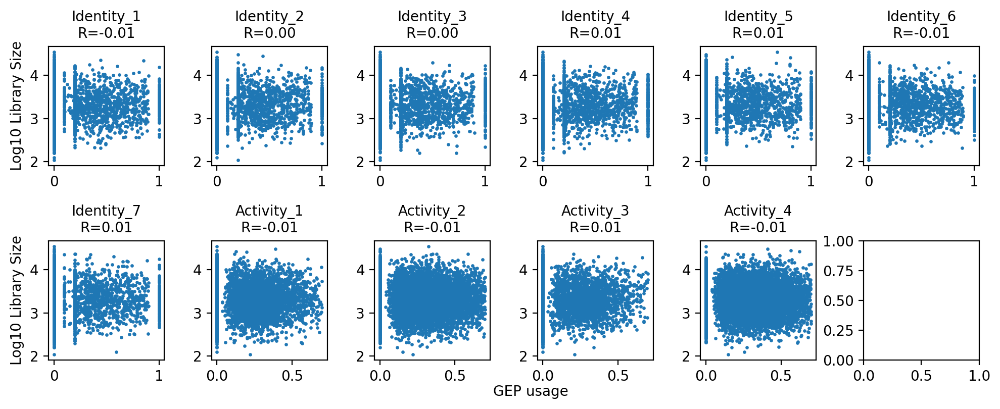

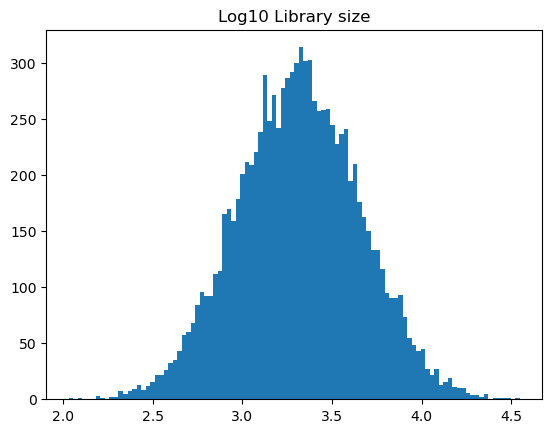

In [7]:
libsize = simmod_catalog.counts.sum(axis=1)
libsize_log = libsize.apply(np.log10)

(fig,axes) = plt.subplots(2, 6, figsize=(10,4), dpi=200)
axes[0,0].set_ylabel('Log10 Library Size')
axes[1,0].set_ylabel('Log10 Library Size')
plt.figtext(.53, 0, 'GEP usage', va='bottom', ha='center')
axes = axes.ravel()

for (i,a) in enumerate(axes):
    if i > 10:
        break
    a.scatter(simmod_catalog.usage.iloc[:,i], libsize_log, s=2)
    R,P = pearsonr(simmod_catalog.usage.iloc[:,i], libsize_log)
    a.set_title(simmod_catalog.usage.columns[i] + '\nR=%.2f' % R, fontsize=10)
    
plt.tight_layout()

plt.figure()
_ = plt.hist(libsize.apply(np.log10), bins=100)
plt.title('Log10 Library size')

### Prepare UMAP for each dataset

/tmp/ipykernel_44984/3706184229.py:5: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
/PHShome/dk718/.conda/envs/py38_r411/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


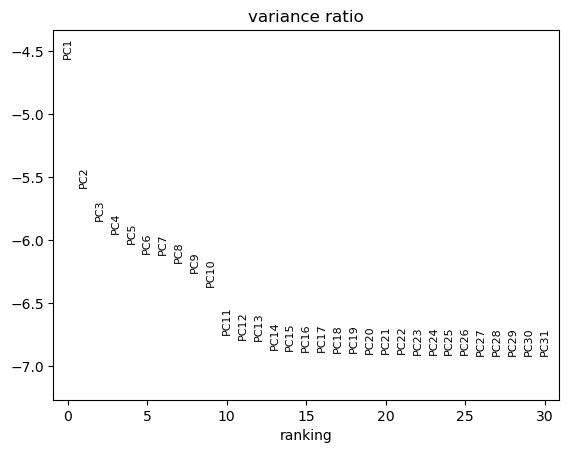

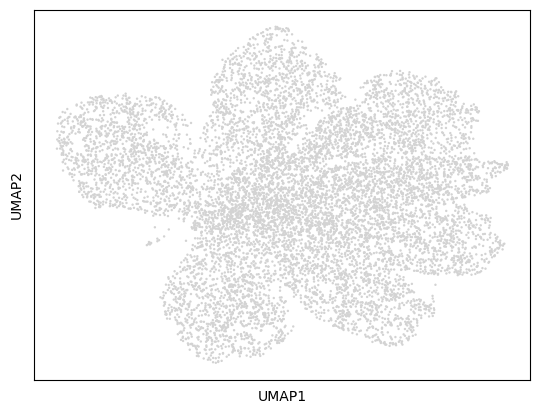

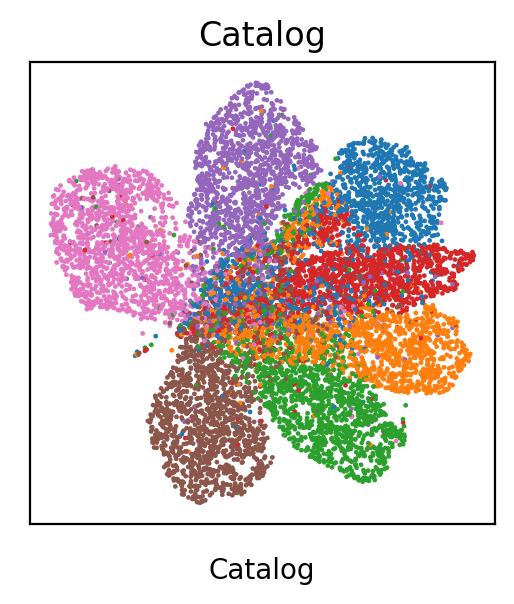

In [9]:
adatas = []
umaps = []
identity_map = dict(zip(np.arange(1,8), sns.color_palette("tab10")))
for (data, label) in [(simmod_catalog, 'Catalog')]:
    a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
    a = process_log(a)
    adatas.append(a)


    umap = pd.DataFrame(a.obsm['X_umap'], index=a.obs.index, columns=['U1', 'U2'])
    umap['identity'] = data.cellparams['Identity']
    umap['color'] = umap['identity'].apply(lambda x: identity_map[x])
    umaps.append(umap)


    (fig,ax) = plt.subplots(1,1, figsize=(3,3), dpi=200)
    ax.scatter(umap['U1'], umap['U2'], c=umap['color'], s=.5)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(label)
    ax.text(.5,-0.1,label, ha='center', va='center', transform=ax.transAxes)

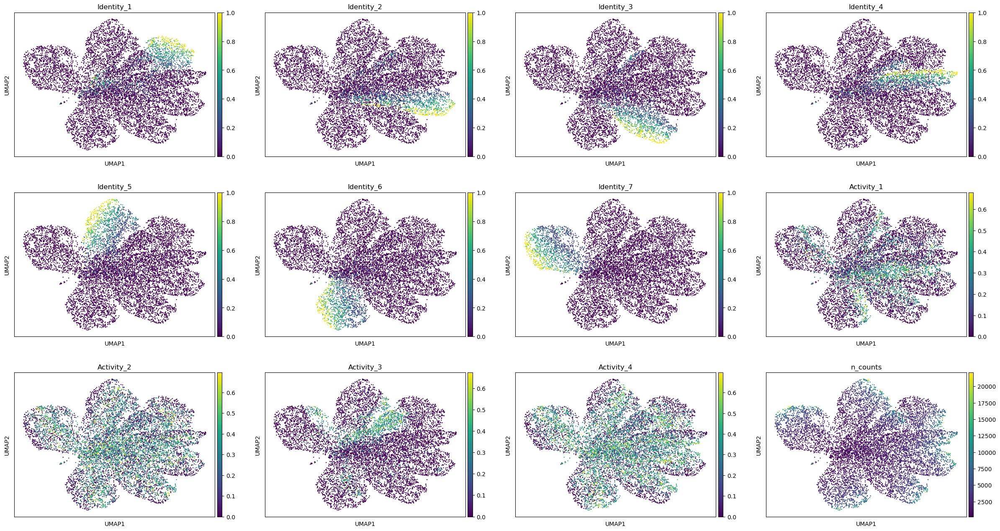

In [10]:
sc.pl.umap(a, color=a.obs.columns, vmax='p99.9')

### Run cNMF for each dataset

/tmp/ipykernel_44984/3552072350.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


/tmp/ipykernel_44984/3552072350.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


/tmp/ipykernel_44984/3552072350.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


/tmp/ipykernel_44984/3552072350.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


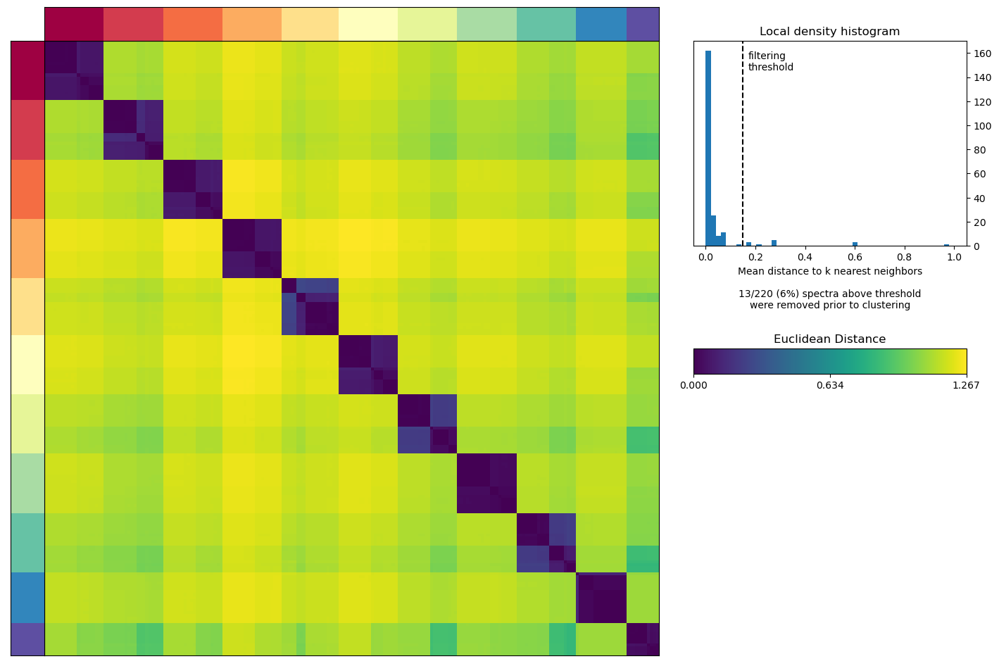

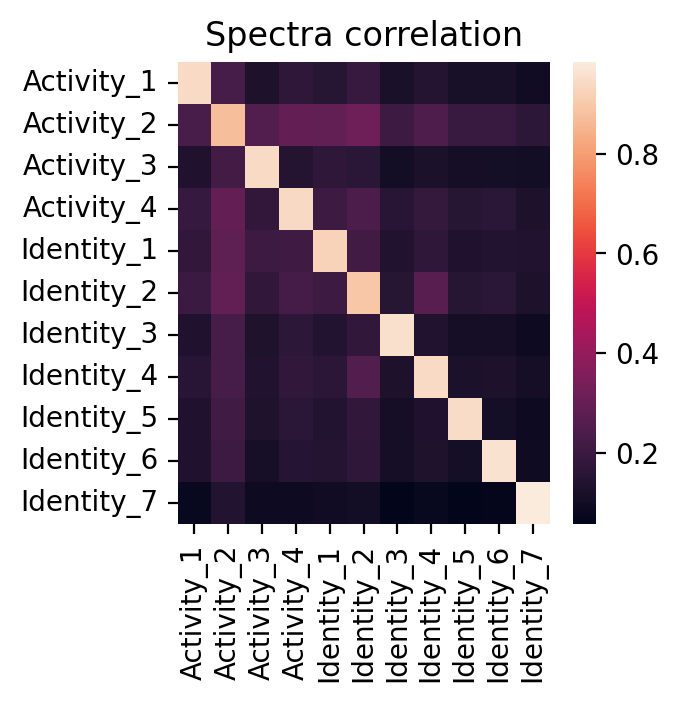

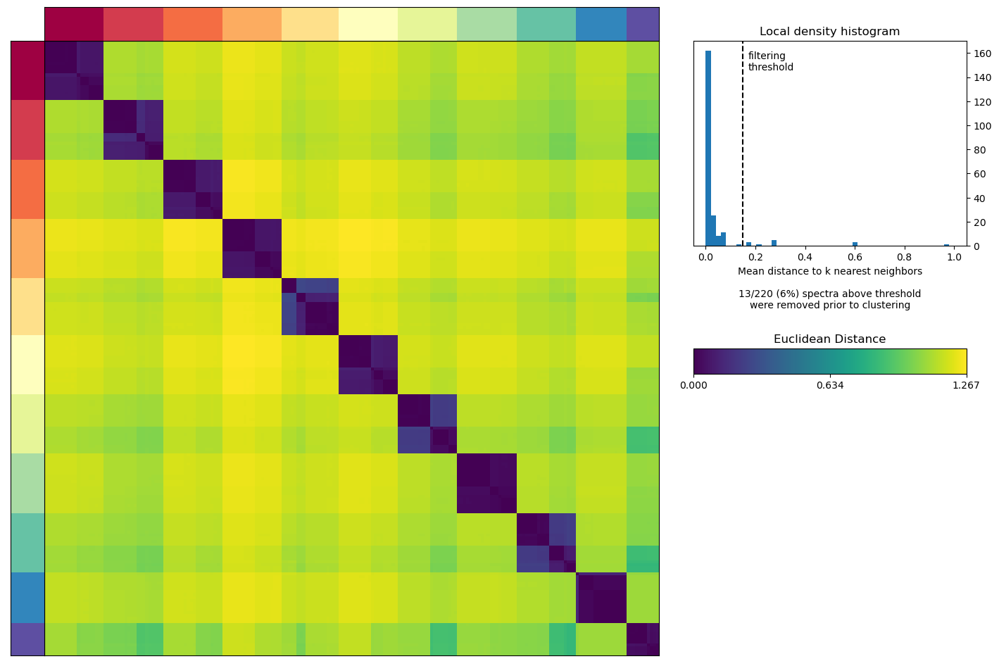

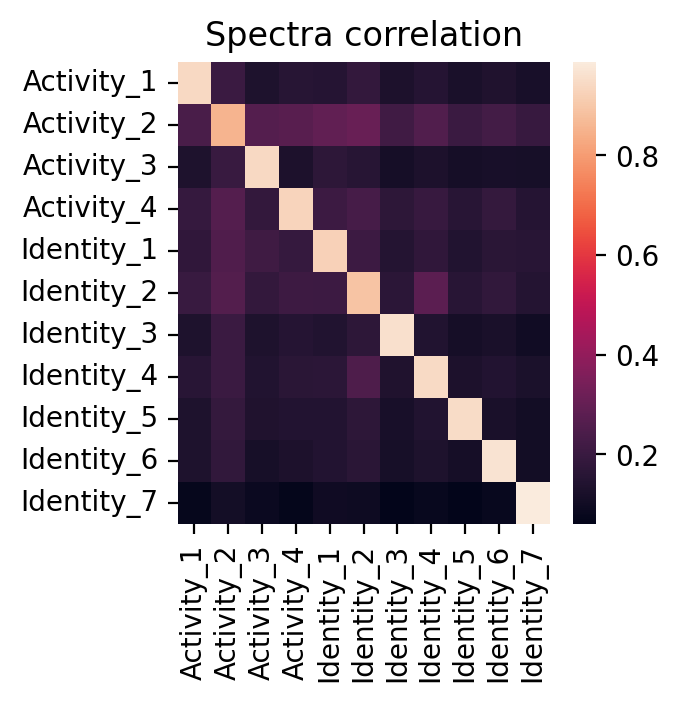

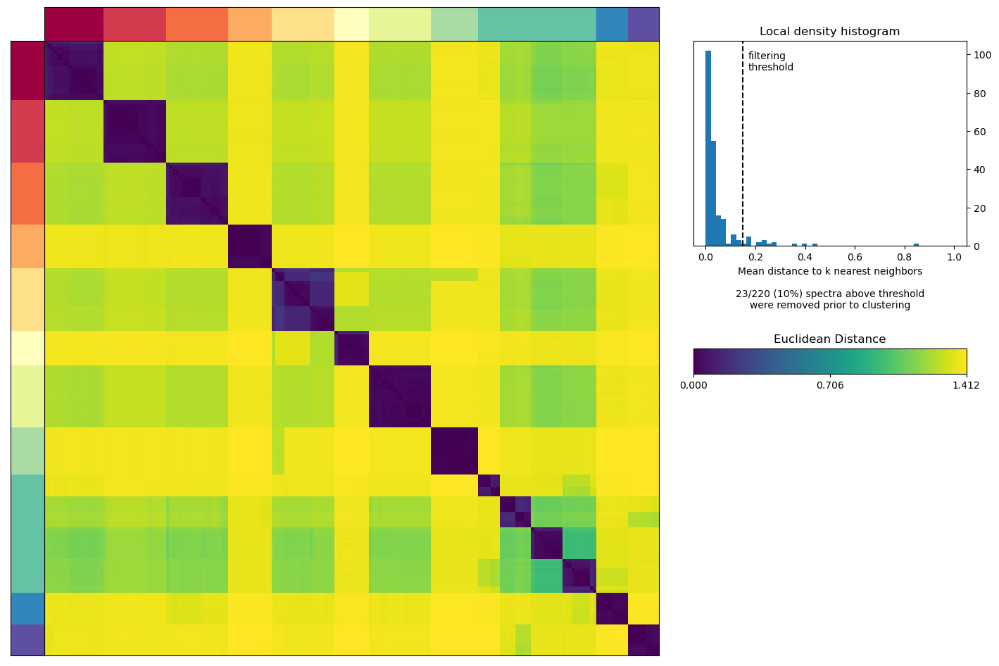

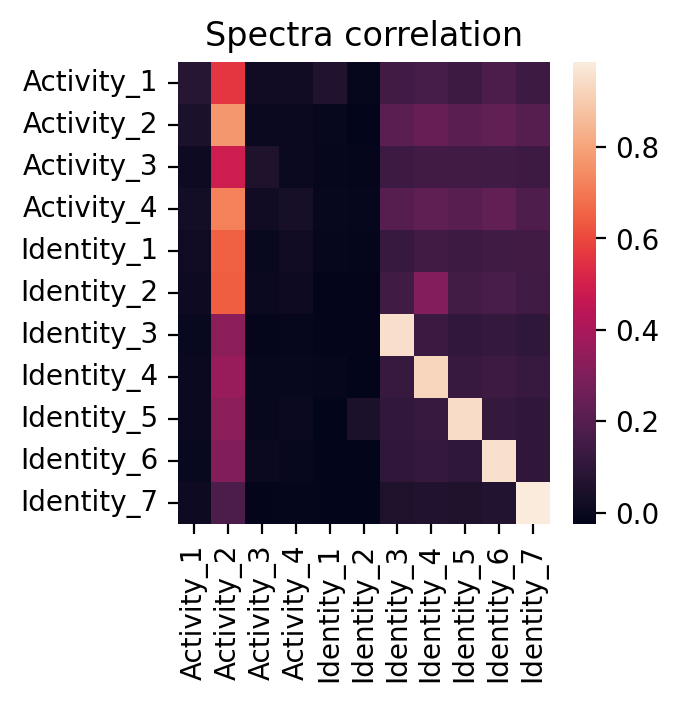

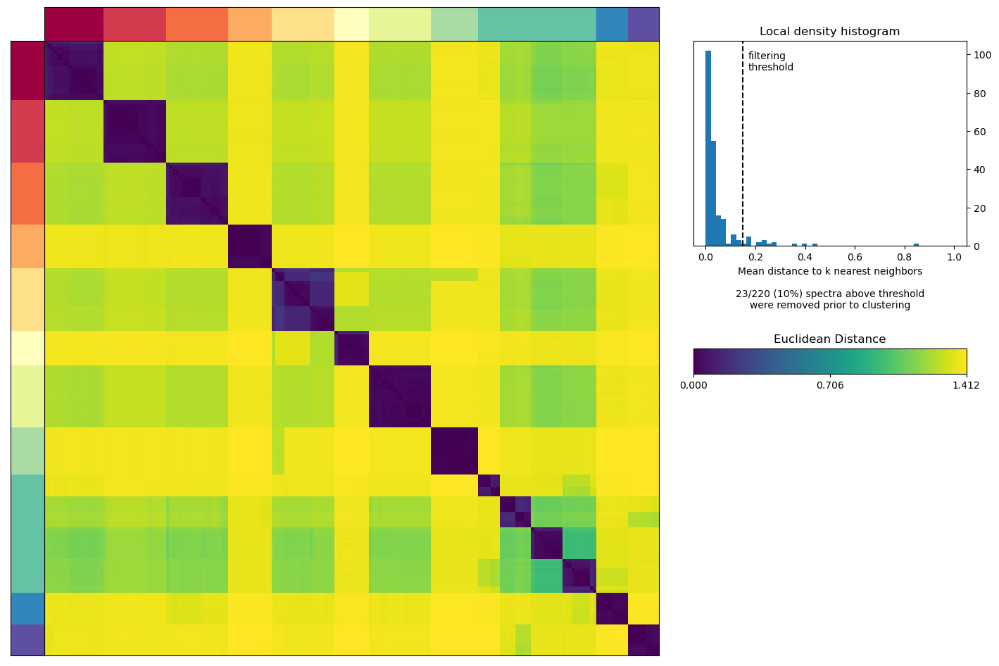

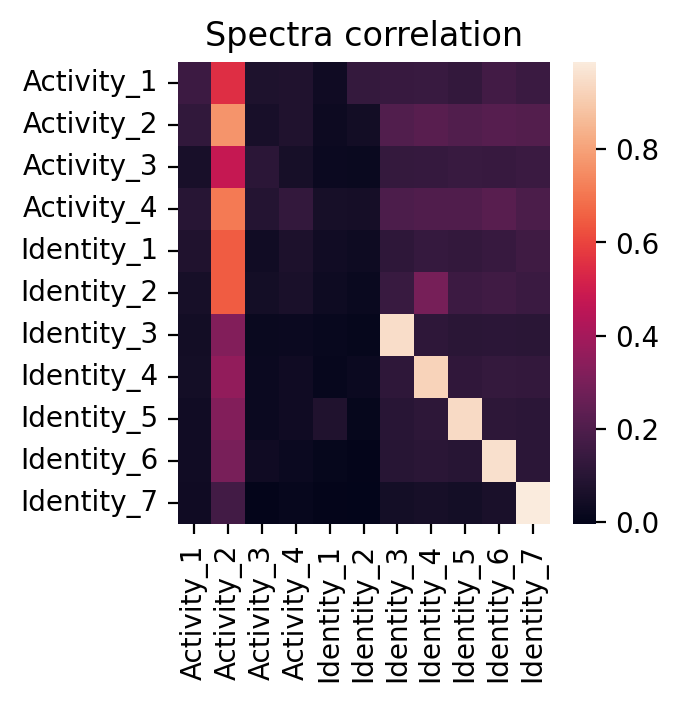

In [13]:
ldthresh = 0.15
all_results = {}
K = simmod_catalog.usage.shape[1]
for (data, label, normalize_tpm_spectra, use_tp10k) in [(simmod_catalog, 'Catalog_Norm', True, False), (simmod_catalog, 'Catalog_NoNorm', False, False),
                                                        (simmod_catalog, 'Catalog_Norm_TP10K', True, True), (simmod_catalog, 'Catalog_NoNorm_TP10K', False, True)]:
    a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()
    sc.pp.filter_genes(a, min_cells=5)
    sc.pp.filter_cells(a, min_counts=200)
    
    if use_tp10k:
        sc.pp.normalize_per_cell(a, counts_per_cell_after=1e4)
    
    countfn = '{d}/{lab}.counts.h5ad'.format(d=datadir, lab=label)
    sc.write(countfn, a)
    data.geneparams.to_csv('{d}/{lab}.geneparams.tsv'.format(d=datadir, lab=label), sep='\t')
    cnmf_obj = cNMF(output_dir=datadir, name=label)
    cnmf_obj.prepare(counts_fn=countfn, components=K, n_iter=20, seed=14, num_highvar_genes=1000)
    cnmf_obj.factorize()
    cnmf_obj.combine()
    cnmf_obj.consensus(k=K, density_threshold=ldthresh, show_clustering=True, refit_usage=True, normalize_tpm_spectra=normalize_tpm_spectra)
    
    res = load_and_relabel(cnmf_obj, data.spectra, K=K, ldthresh=ldthresh)
    all_results[label] = res
    

Text(0.5, -36.680555555555586, 'Ground truth GEP')

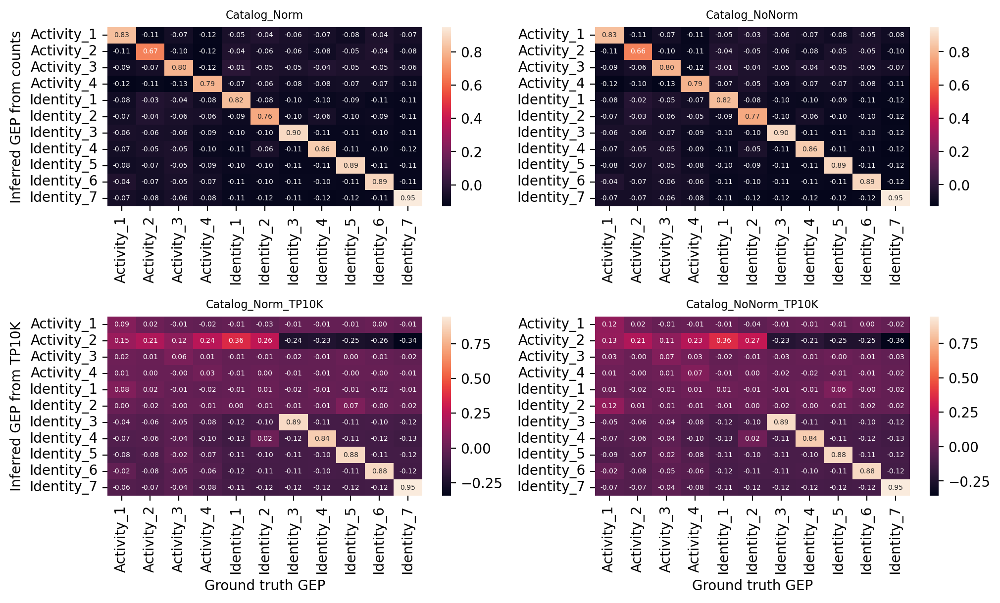

In [14]:
ks = ['Catalog_Norm', 'Catalog_NoNorm', 'Catalog_Norm_TP10K', 'Catalog_NoNorm_TP10K']
(fig,axes) = plt.subplots(2,2, figsize=(10, 6), dpi=200)
axes[1, 0].set_xlabel('Ground truth GEP')
axes[1, 1].set_xlabel('Ground truth GEP')

axes = axes.ravel()


for i,k in enumerate(ks):
    U = all_results[k]['usage']
    R = df_col_corr(U, simmod_catalog.usage.loc[U.index,:].sort_index(axis=1))
    sns.heatmap(R, ax=axes[i], annot=True, fmt='.2f', annot_kws={'fontsize':5},)
    axes[i].set_title(k, fontsize=8)
    
    
plt.tight_layout()
axes[0].set_ylabel('Inferred GEP from counts')
axes[2].set_ylabel('Inferred GEP from TP10K')
axes[2].set_xlabel('Ground truth GEP')
axes[3].set_xlabel('Ground truth GEP')


# Simulation with different sized GEPs but shouldn't actually impact library size

In [38]:
deprob = [.025]*7 + [.05]*2 + [.025]*2
deloc = [1.5]*7 + [2.00]*2 + [1.5]*2
simmod_catalog = SCsim_DiffScale(seed=112)
simmod_catalog.simulate(ncells=20000, ngenes=10000, nidentities=7, activity_pct=[.3]*4,
                activity_min=[.1]*4, activity_max=[.7]*4,
                activity_identities=[list(range(1,8))]*4,
                pct_doublets=.05, diffexploc=deloc, diffexpscale=1, diffexpprob=deprob,
                delta_range_libloc=0)

simmod_catalog.spectra.sum(axis=1)

Simulating gene params
Simulating DE
['Identity_1', 'Identity_2', 'Identity_3', 'Identity_4', 'Identity_5', 'Identity_6', 'Identity_7', 'Activity_1', 'Activity_2', 'Activity_3', 'Activity_4']
Simulating cells
Simulating doublets
Simulating cell-gene means
Adjusting means
Simulating counts


Identity_1     809.016449
Identity_2     761.197865
Identity_3     741.717422
Identity_4     703.138881
Identity_5     756.720819
Identity_6     756.433905
Identity_7     703.271651
Activity_1    1347.784715
Activity_2    1286.650729
Activity_3     751.684771
Activity_4     721.271268
dtype: float64

Text(0.5, 1.0, 'Log10 Library size')

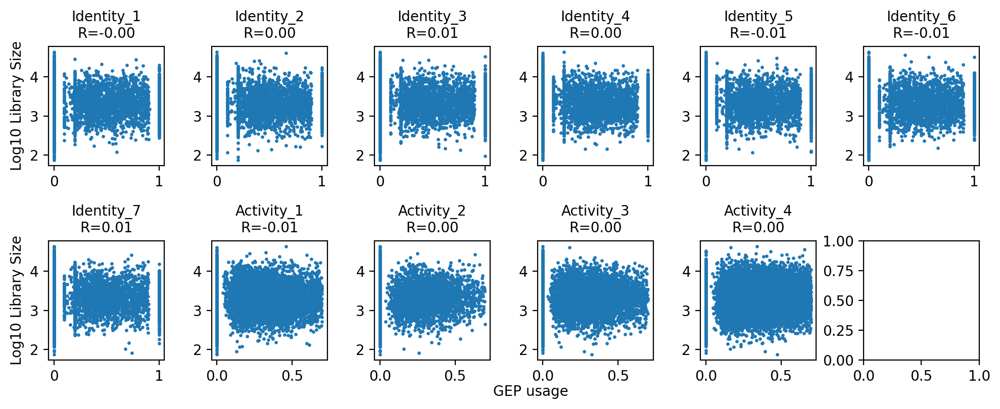

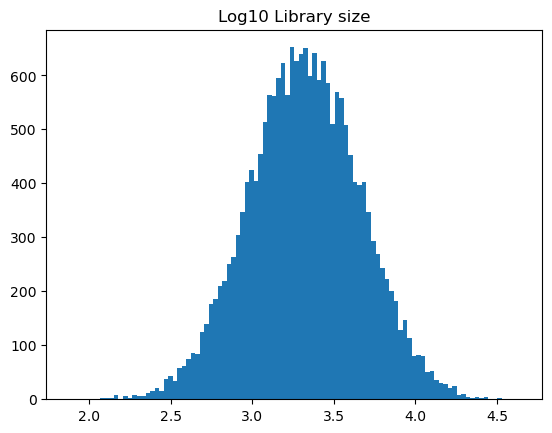

In [39]:
libsize = simmod_catalog.counts.sum(axis=1)
libsize_log = libsize.apply(np.log10)

(fig,axes) = plt.subplots(2, 6, figsize=(10,4), dpi=200)
axes[0,0].set_ylabel('Log10 Library Size')
axes[1,0].set_ylabel('Log10 Library Size')
plt.figtext(.53, 0, 'GEP usage', va='bottom', ha='center')
axes = axes.ravel()

for (i,a) in enumerate(axes):
    if i > 10:
        break
    a.scatter(simmod_catalog.usage.iloc[:,i], libsize_log, s=2)
    R,P = pearsonr(simmod_catalog.usage.iloc[:,i], libsize_log)
    a.set_title(simmod_catalog.usage.columns[i] + '\nR=%.2f' % R, fontsize=10)
    
plt.tight_layout()

plt.figure()
_ = plt.hist(libsize.apply(np.log10), bins=100)
plt.title('Log10 Library size')

/tmp/ipykernel_44984/1921325542.py:8: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
/PHShome/dk718/.conda/envs/py38_r411/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


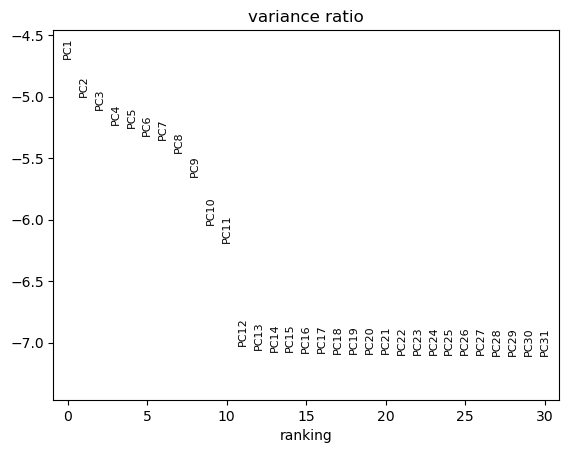

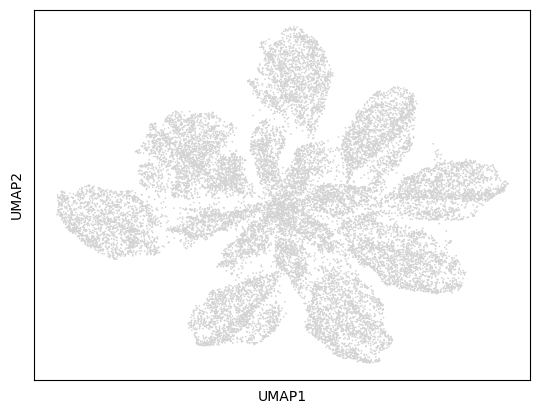

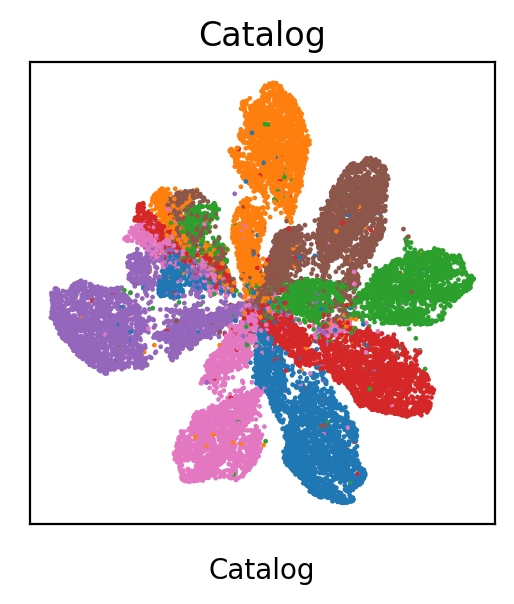

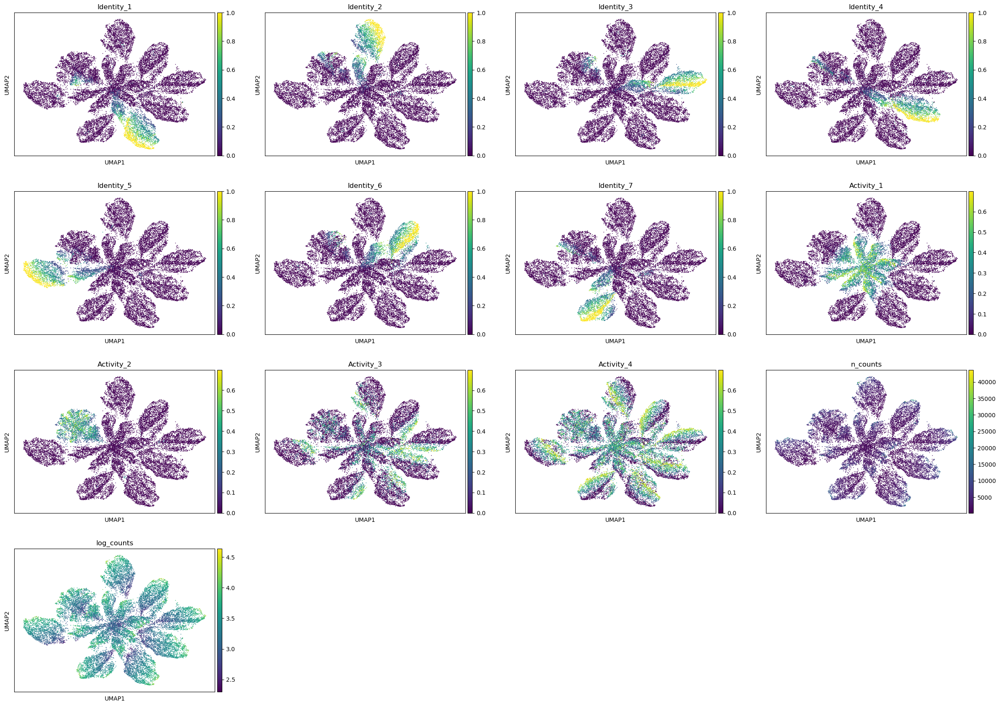

In [40]:
adatas = []
umaps = []
identity_map = dict(zip(np.arange(1,8), sns.color_palette("tab10")))


for (data, label) in [(simmod_catalog, 'Catalog')]:
    a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
    a = process_log(a)
    adatas.append(a)


    umap = pd.DataFrame(a.obsm['X_umap'], index=a.obs.index, columns=['U1', 'U2'])
    umap['identity'] = data.cellparams['Identity']
    umap['color'] = umap['identity'].apply(lambda x: identity_map[x])
    umaps.append(umap)


    (fig,ax) = plt.subplots(1,1, figsize=(3,3), dpi=200)
    ax.scatter(umap['U1'], umap['U2'], c=umap['color'], s=.5)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(label)
    ax.text(.5,-0.1,label, ha='center', va='center', transform=ax.transAxes)
    
a.obs['log_counts'] = a.obs['n_counts'].apply(np.log10)
sc.pl.umap(a, color=a.obs.columns)

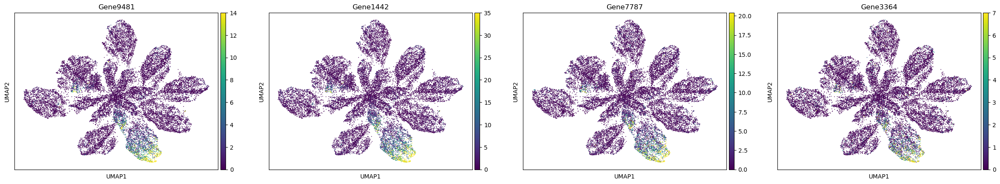

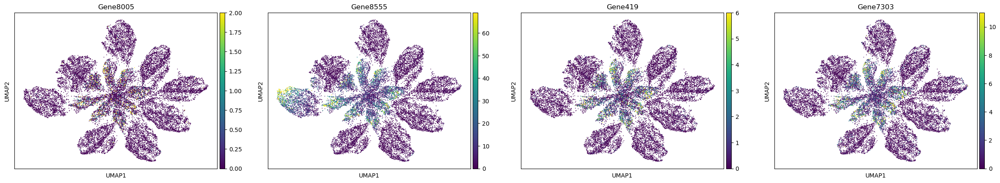

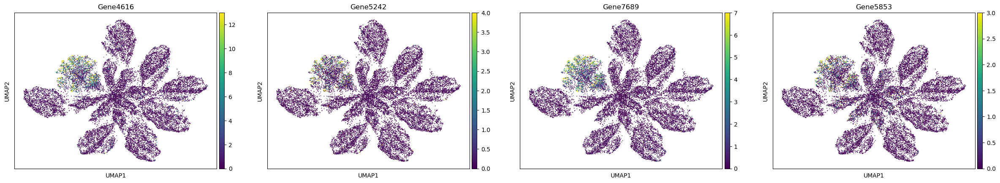

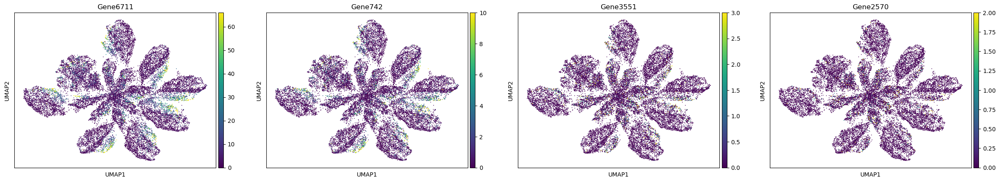

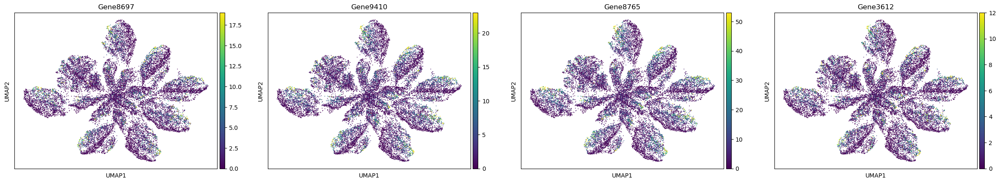

In [41]:
sc.pl.umap(a, color=a.var.sort_values(by='Identity_1.DEratio', ascending=False).index[:4], vmax='p99')
sc.pl.umap(a, color=a.var.sort_values(by='Activity_1.DEratio', ascending=False).index[:4], vmax='p99')
sc.pl.umap(a, color=a.var.sort_values(by='Activity_2.DEratio', ascending=False).index[:4], vmax='p99')
sc.pl.umap(a, color=a.var.sort_values(by='Activity_3.DEratio', ascending=False).index[:4], vmax='p99')
sc.pl.umap(a, color=a.var.sort_values(by='Activity_4.DEratio', ascending=False).index[:4], vmax='p99')

/tmp/ipykernel_44984/1733431322.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


/tmp/ipykernel_44984/1733431322.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


/tmp/ipykernel_44984/1733431322.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


/tmp/ipykernel_44984/1733431322.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


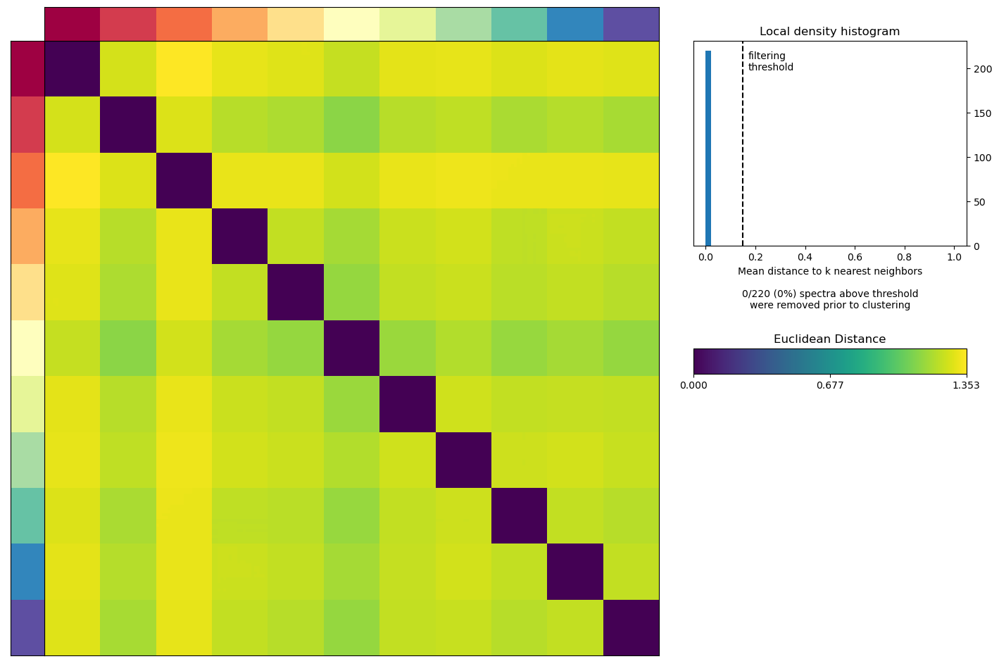

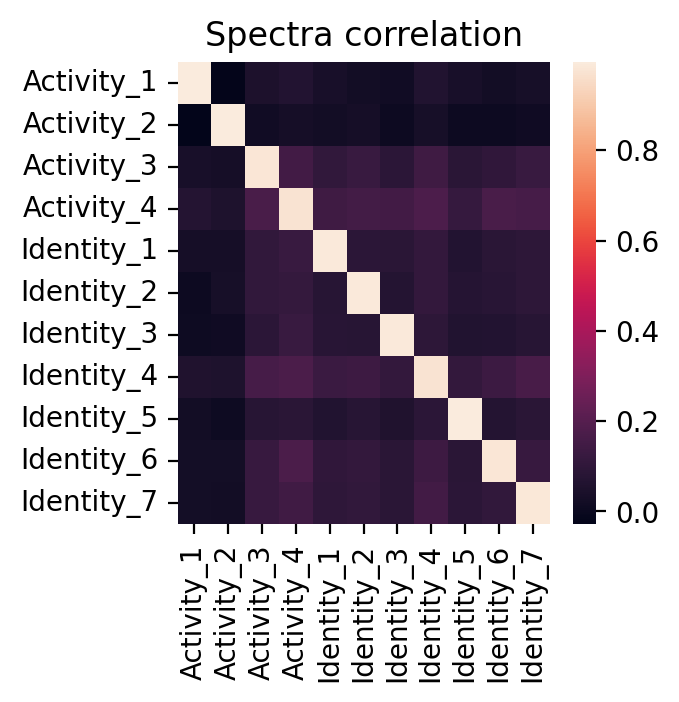

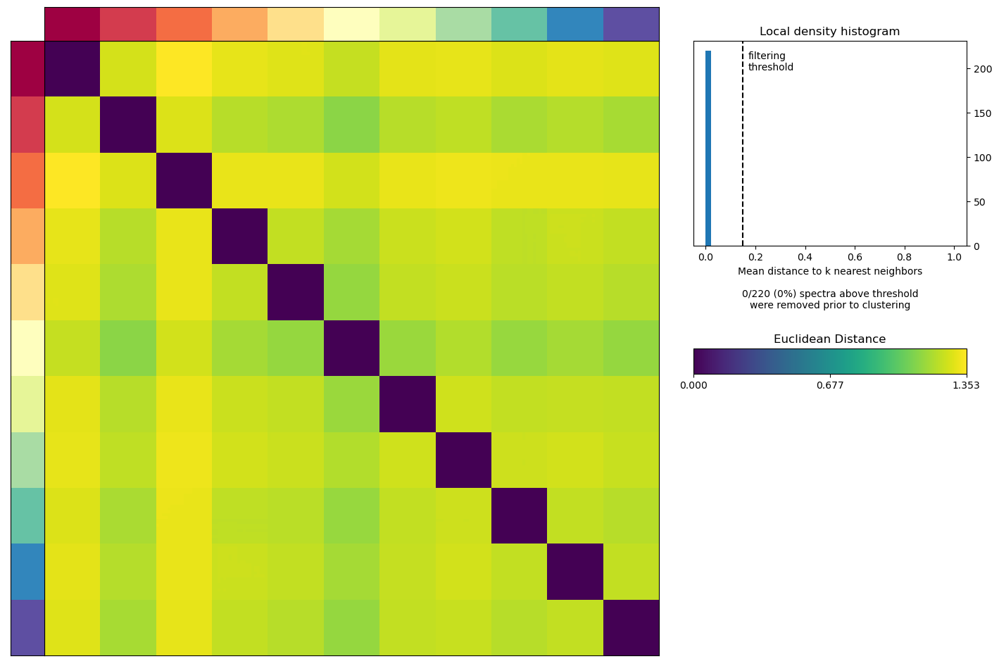

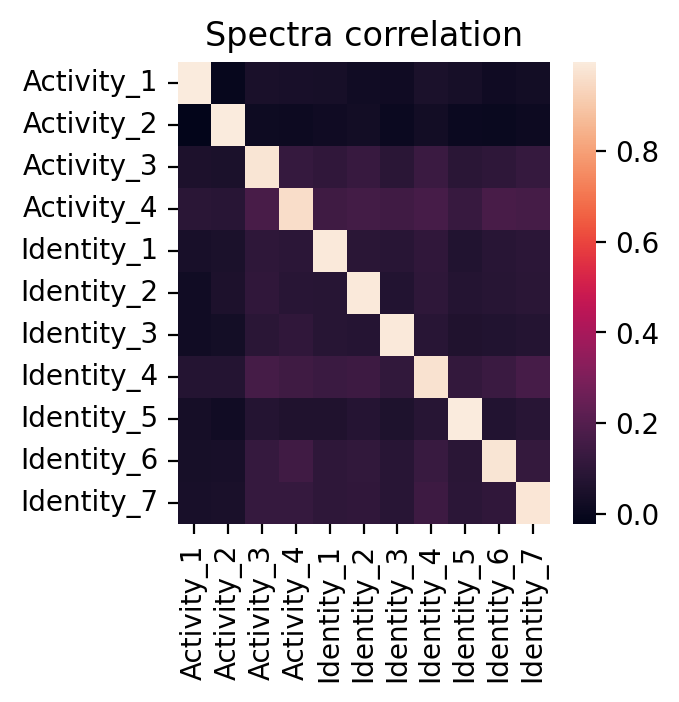

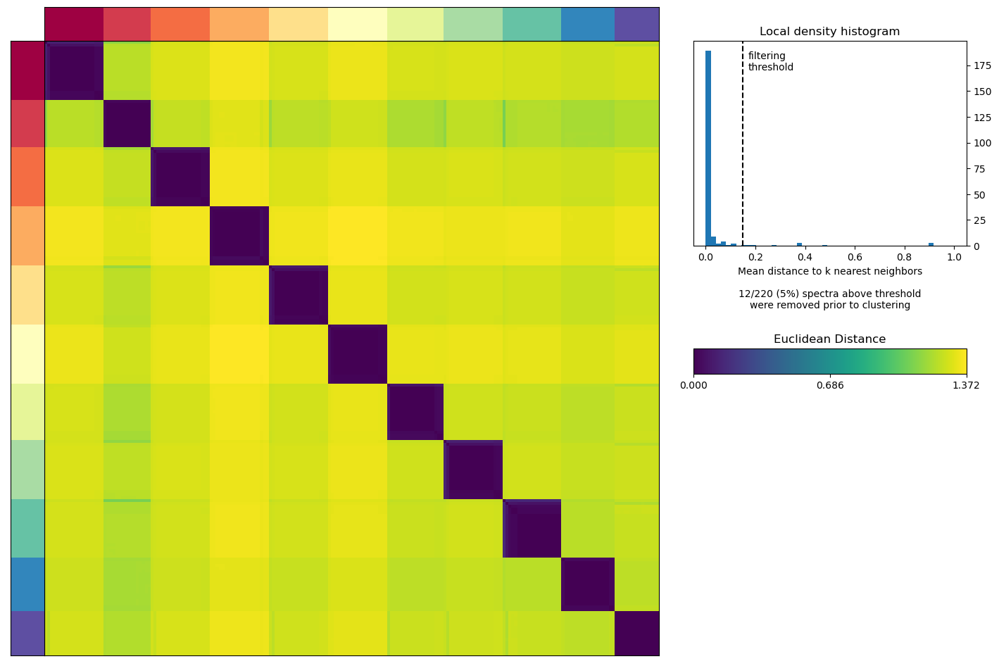

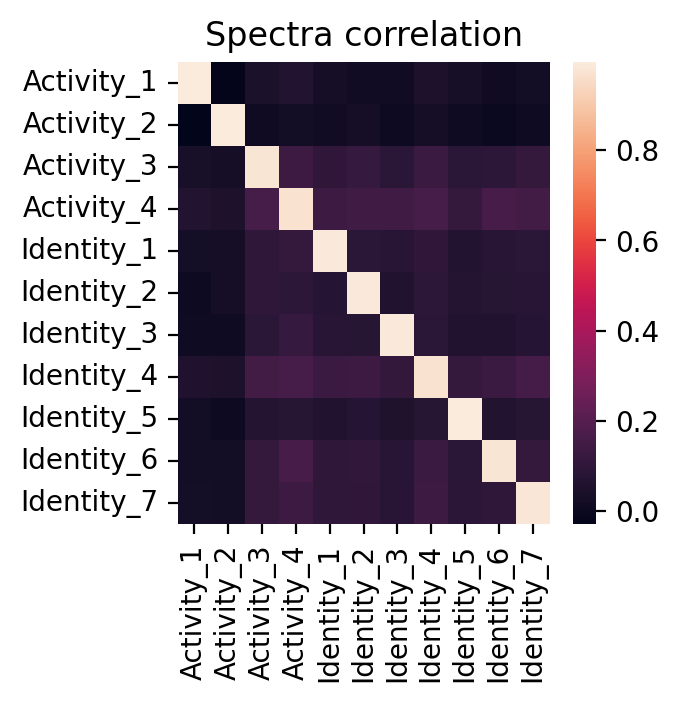

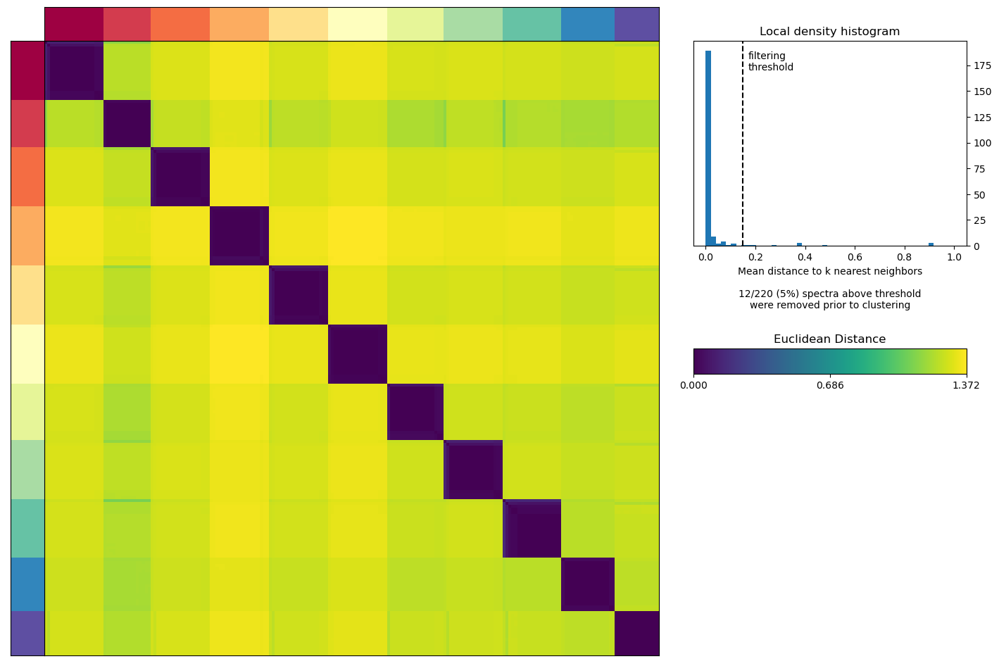

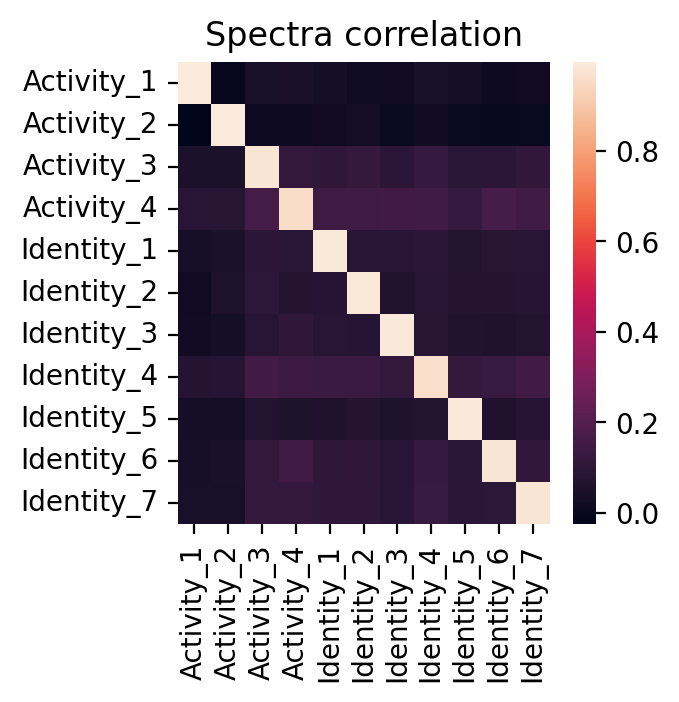

In [42]:
ldthresh = 0.15
all_results = {}
K = simmod_catalog.usage.shape[1]
for (data, label, normalize_tpm_spectra, use_tp10k) in [(simmod_catalog, 'Catalog_Norm_VariableGEPMagnitude', True, False), (simmod_catalog, 'Catalog_NoNorm_VariableGEPMagnitude', False, False),
                                                        (simmod_catalog, 'Catalog_Norm_VariableGEPMagnitude_TP10K', True, True), (simmod_catalog, 'Catalog_NoNorm_VariableGEPMagnitude_TP10K', False, True)]:
    a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()
    sc.pp.filter_genes(a, min_cells=5)
    sc.pp.filter_cells(a, min_counts=200)
    
    if use_tp10k:
        sc.pp.normalize_per_cell(a, counts_per_cell_after=1e4)
    
    countfn = '{d}/{lab}.counts.h5ad'.format(d=datadir, lab=label)
    sc.write(countfn, a)
    data.geneparams.to_csv('{d}/{lab}.geneparams.tsv'.format(d=datadir, lab=label), sep='\t')
    cnmf_obj = cNMF(output_dir=datadir, name=label)
    cnmf_obj.prepare(counts_fn=countfn, components=K, n_iter=20, seed=14, num_highvar_genes=1000)
    cnmf_obj.factorize()
    cnmf_obj.combine()
    cnmf_obj.consensus(k=K, density_threshold=ldthresh, show_clustering=True, refit_usage=True, normalize_tpm_spectra=normalize_tpm_spectra)
    
    res = load_and_relabel(cnmf_obj, data.spectra, K=K, ldthresh=ldthresh)
    all_results[label] = res
    

In [43]:
all_results.keys()

dict_keys(['Catalog_Norm_VariableGEPMagnitude', 'Catalog_NoNorm_VariableGEPMagnitude', 'Catalog_Norm_VariableGEPMagnitude_TP10K', 'Catalog_NoNorm_VariableGEPMagnitude_TP10K'])

Text(0.5, -36.680555555555586, 'Ground truth GEP')

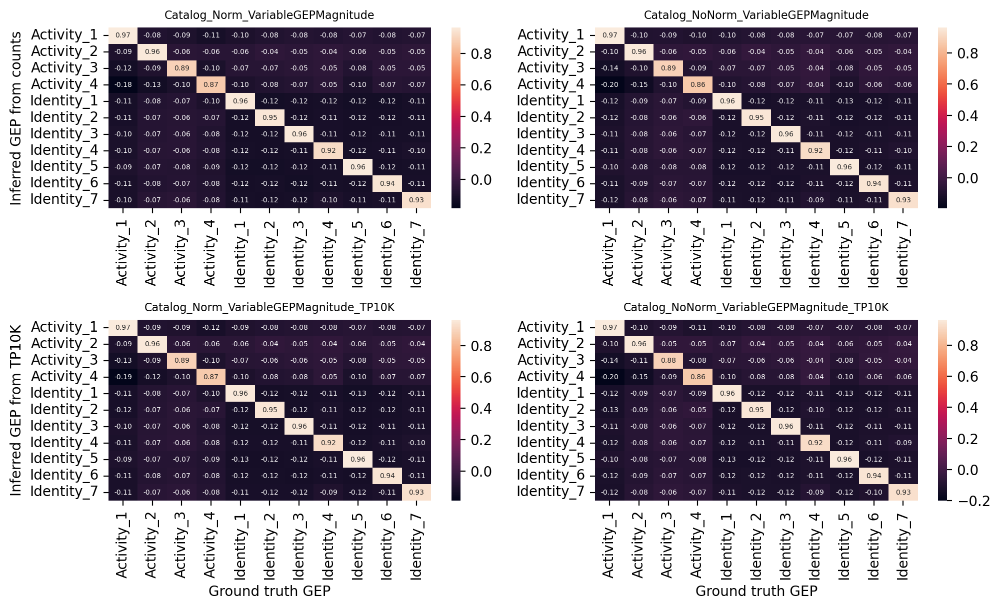

In [44]:
ks = ['Catalog_Norm_VariableGEPMagnitude', 'Catalog_NoNorm_VariableGEPMagnitude', 'Catalog_Norm_VariableGEPMagnitude_TP10K', 'Catalog_NoNorm_VariableGEPMagnitude_TP10K']
(fig,axes) = plt.subplots(2,2, figsize=(10, 6), dpi=200)
axes[1, 0].set_xlabel('Ground truth GEP')
axes[1, 1].set_xlabel('Ground truth GEP')

axes = axes.ravel()


for i,k in enumerate(ks):
    U = all_results[k]['usage']
    R = df_col_corr(U, simmod_catalog.usage.loc[U.index,:].sort_index(axis=1))
    sns.heatmap(R, ax=axes[i], annot=True, fmt='.2f', annot_kws={'fontsize':5},)
    axes[i].set_title(k, fontsize=8)
    
    
plt.tight_layout()
axes[0].set_ylabel('Inferred GEP from counts')
axes[2].set_ylabel('Inferred GEP from TP10K')
axes[2].set_xlabel('Ground truth GEP')
axes[3].set_xlabel('Ground truth GEP')

# Simulation with different sized GEPs that should impact library size

In [45]:
deprob = [.025]*7 + [.05]*2 + [.025]*2
deloc = [1.5]*7 + [2.00]*2 + [1.5]*2
simmod_catalog = SCsim_DiffScale(seed=242)
simmod_catalog.simulate(ncells=20000, ngenes=10000, nidentities=7, activity_pct=[.3]*4,
                activity_min=[.1]*4, activity_max=[.7]*4,
                activity_identities=[list(range(1,8))]*4,
                pct_doublets=.05, diffexploc=deloc, diffexpscale=1, diffexpprob=deprob,
                delta_range_libloc=.25)

simmod_catalog.spectra.sum(axis=1)

Simulating gene params
Simulating DE
['Identity_1', 'Identity_2', 'Identity_3', 'Identity_4', 'Identity_5', 'Identity_6', 'Identity_7', 'Activity_1', 'Activity_2', 'Activity_3', 'Activity_4']
Simulating cells
Simulating doublets
Simulating cell-gene means
Adjusting means
Simulating counts


Identity_1    671.951972
Identity_2    677.110862
Identity_3    744.159560
Identity_4    684.734172
Identity_5    712.146480
Identity_6    740.295266
Identity_7    670.786994
Activity_1    886.421811
Activity_2    802.616340
Activity_3    692.668586
Activity_4    720.823754
dtype: float64

Text(0.5, 1.0, 'Log10 Library size')

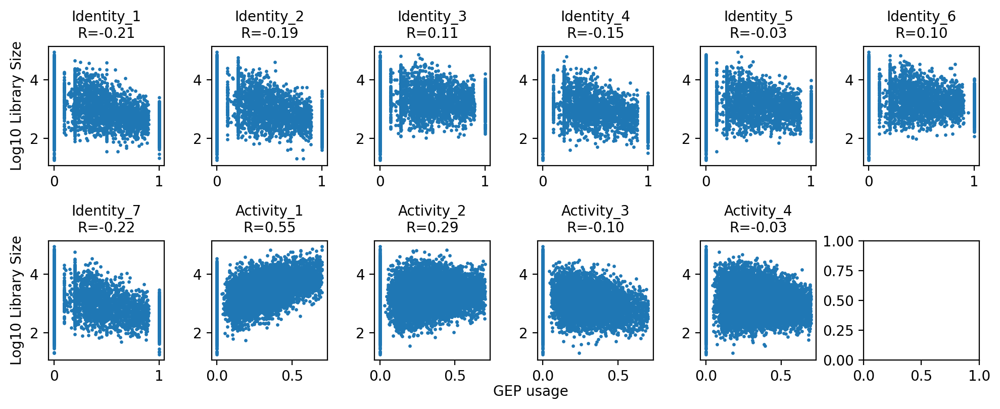

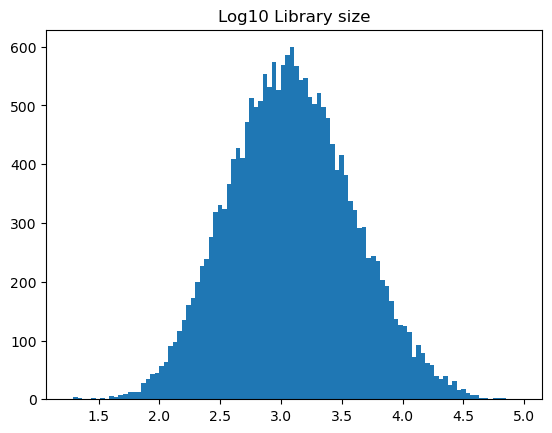

In [46]:
libsize = simmod_catalog.counts.sum(axis=1)
libsize_log = libsize.apply(np.log10)

(fig,axes) = plt.subplots(2, 6, figsize=(10,4), dpi=200)
axes[0,0].set_ylabel('Log10 Library Size')
axes[1,0].set_ylabel('Log10 Library Size')
plt.figtext(.53, 0, 'GEP usage', va='bottom', ha='center')
axes = axes.ravel()

for (i,a) in enumerate(axes):
    if i > 10:
        break
    a.scatter(simmod_catalog.usage.iloc[:,i], libsize_log, s=2)
    R,P = pearsonr(simmod_catalog.usage.iloc[:,i], libsize_log)
    a.set_title(simmod_catalog.usage.columns[i] + '\nR=%.2f' % R, fontsize=10)
    
plt.tight_layout()

plt.figure()
_ = plt.hist(libsize.apply(np.log10), bins=100)
plt.title('Log10 Library size')

/tmp/ipykernel_44984/1921325542.py:8: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
/PHShome/dk718/.conda/envs/py38_r411/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


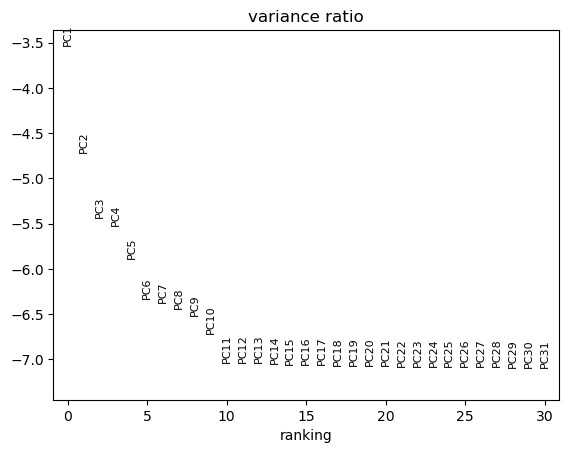

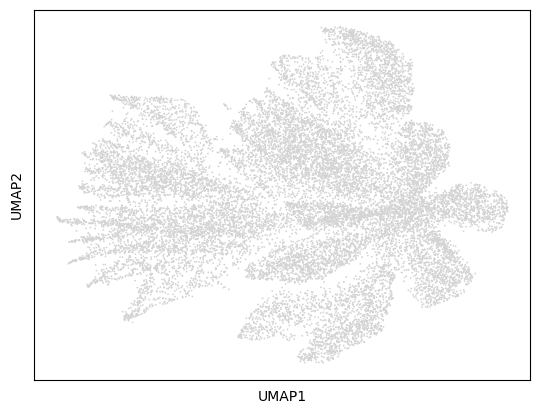

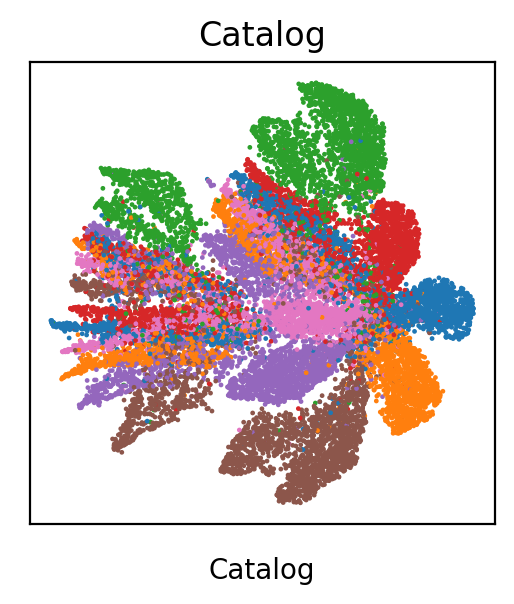

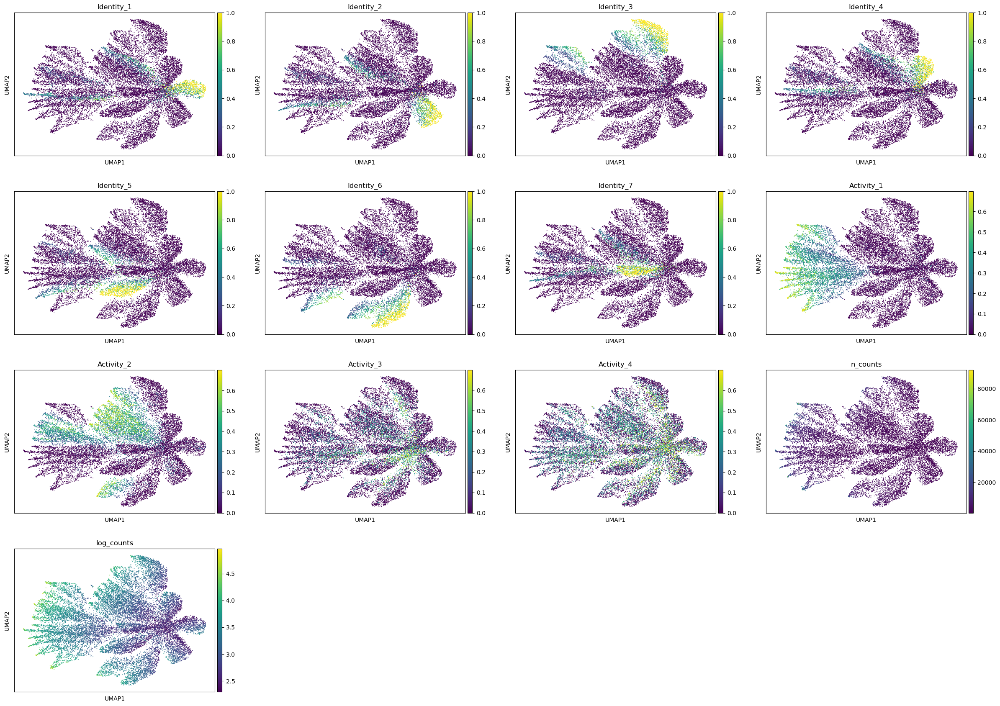

In [47]:
adatas = []
umaps = []
identity_map = dict(zip(np.arange(1,8), sns.color_palette("tab10")))
strmap = {'Ref1 - Sim2':'Identity:1,2,3,4,5,6\nActivity:1,2,3', 'Ref2 - Sim2':'Identity:2,3,4,5,6,7\nActivity:2,3,4', 'Query - Sim2':'Identity:1,2,3,4,7\nActivity:1,2'}


for (data, label) in [(simmod_catalog, 'Catalog')]:
    a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
    a = process_log(a)
    adatas.append(a)


    umap = pd.DataFrame(a.obsm['X_umap'], index=a.obs.index, columns=['U1', 'U2'])
    umap['identity'] = data.cellparams['Identity']
    umap['color'] = umap['identity'].apply(lambda x: identity_map[x])
    umaps.append(umap)


    (fig,ax) = plt.subplots(1,1, figsize=(3,3), dpi=200)
    ax.scatter(umap['U1'], umap['U2'], c=umap['color'], s=.5)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(label)
    ax.text(.5,-0.1,label, ha='center', va='center', transform=ax.transAxes)
    
a.obs['log_counts'] = a.obs['n_counts'].apply(np.log10)
sc.pl.umap(a, color=a.obs.columns)

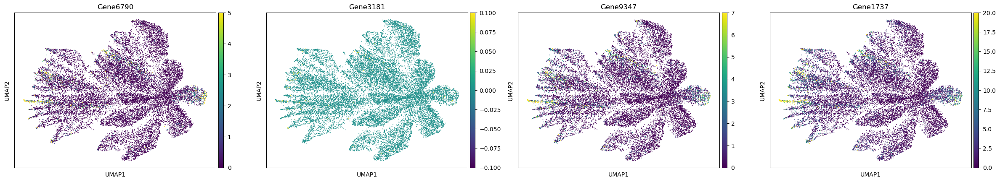

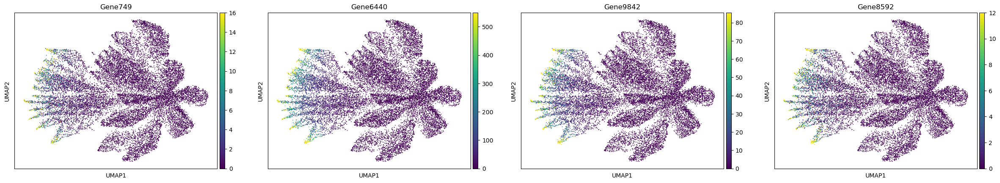

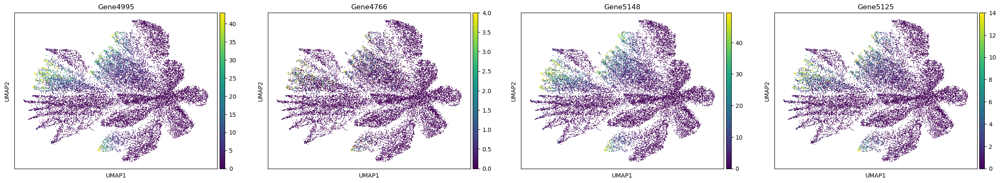

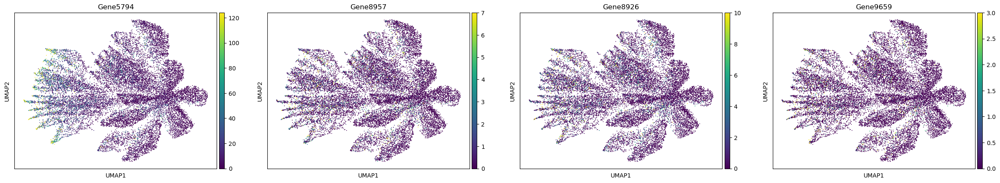

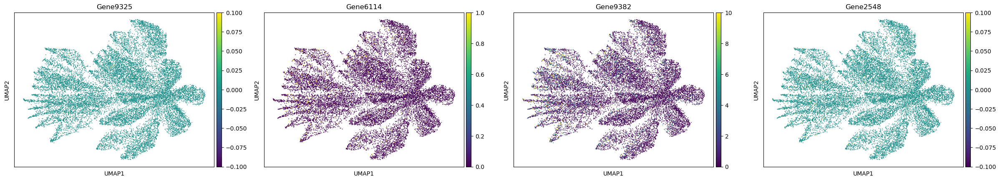

In [48]:
sc.pl.umap(a, color=a.var.sort_values(by='Identity_1.DEratio', ascending=False).index[:4], vmax='p99')
sc.pl.umap(a, color=a.var.sort_values(by='Activity_1.DEratio', ascending=False).index[:4], vmax='p99')
sc.pl.umap(a, color=a.var.sort_values(by='Activity_2.DEratio', ascending=False).index[:4], vmax='p99')
sc.pl.umap(a, color=a.var.sort_values(by='Activity_3.DEratio', ascending=False).index[:4], vmax='p99')
sc.pl.umap(a, color=a.var.sort_values(by='Activity_4.DEratio', ascending=False).index[:4], vmax='p99')

/tmp/ipykernel_44984/1711855523.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


/tmp/ipykernel_44984/1711855523.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


/tmp/ipykernel_44984/1711855523.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


/tmp/ipykernel_44984/1711855523.py:6: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
Combining factorizations for k=11.


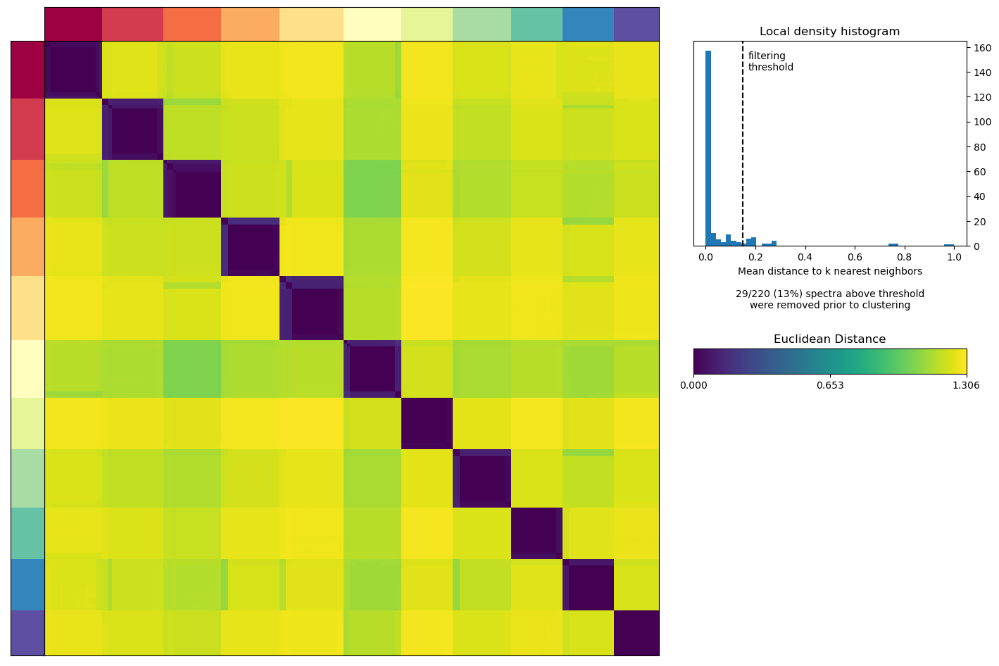

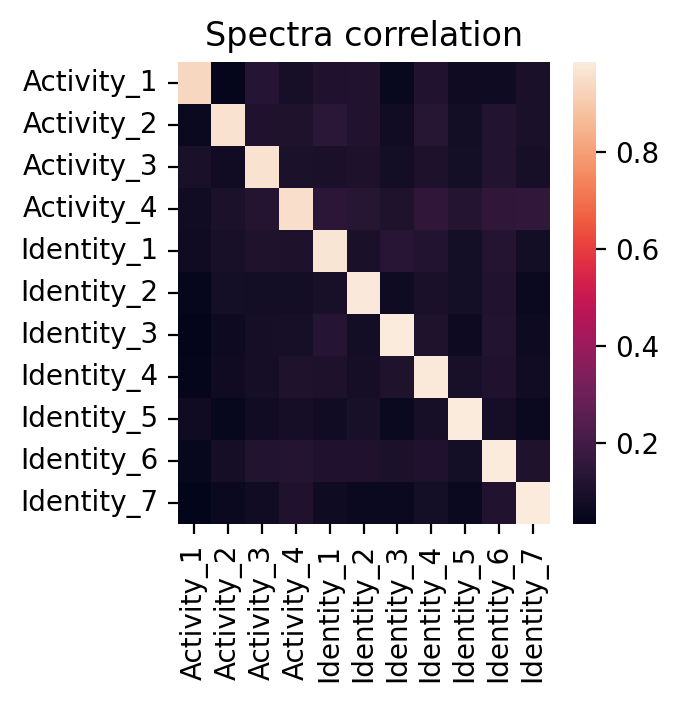

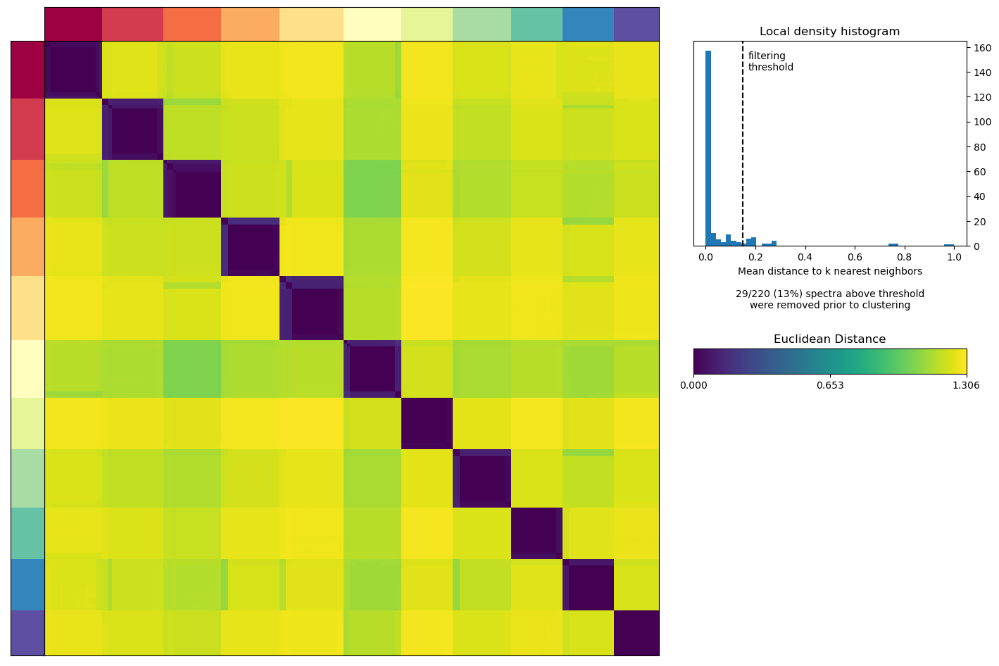

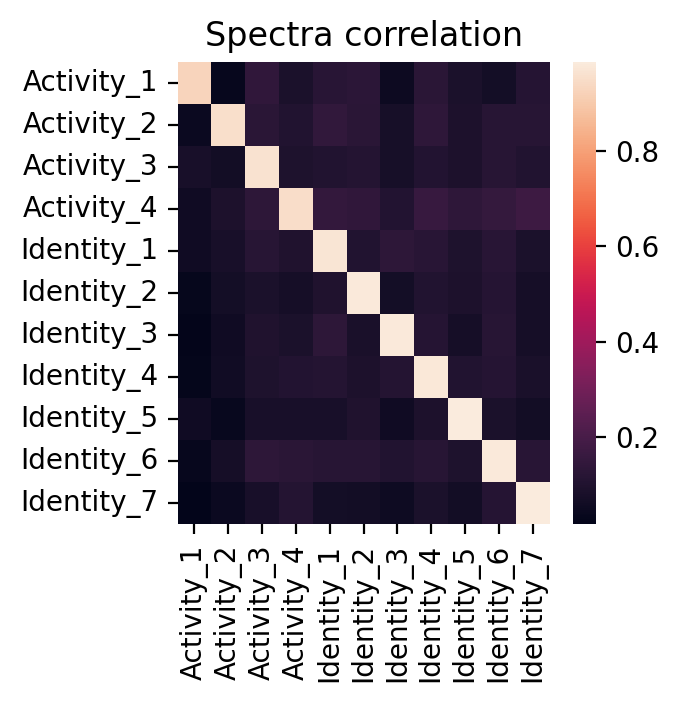

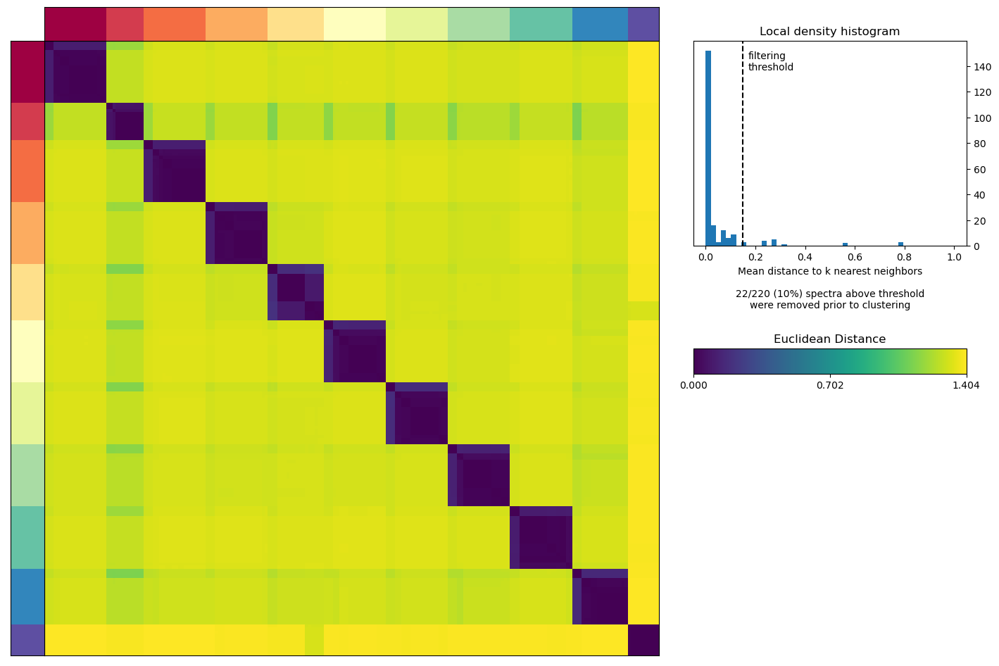

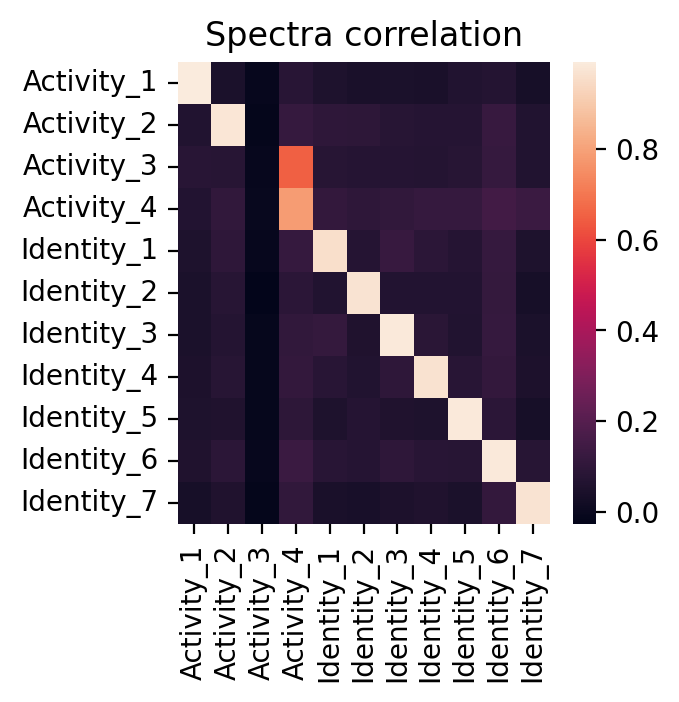

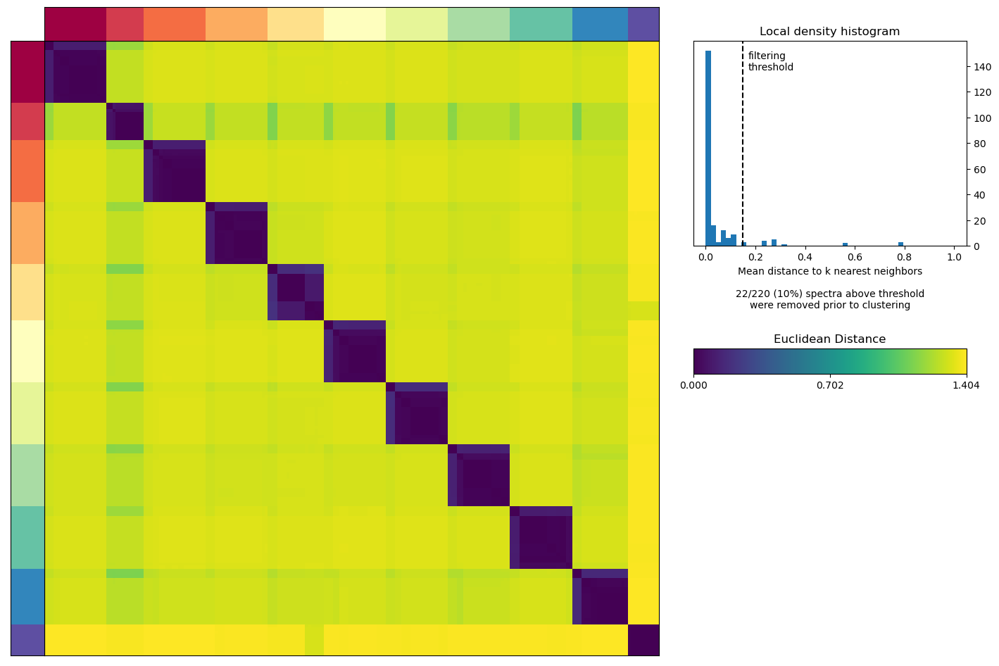

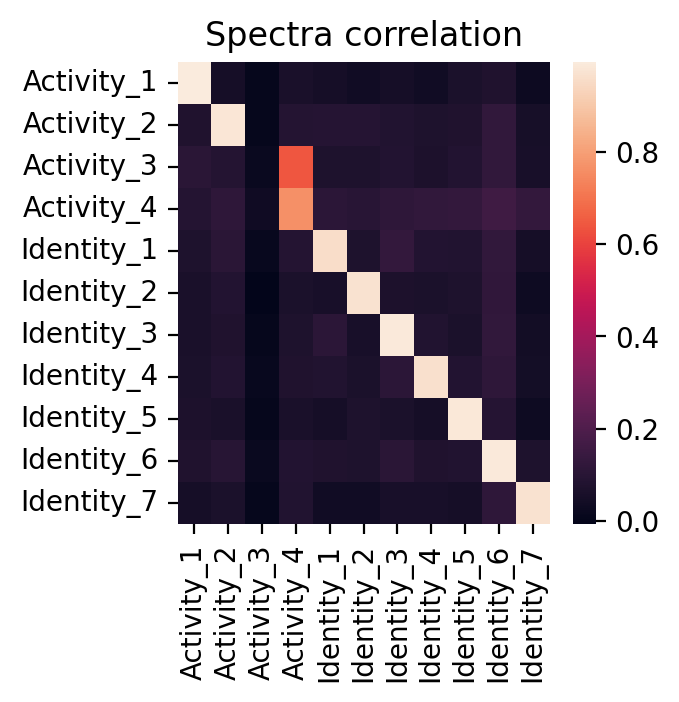

In [49]:
ldthresh = 0.15
all_results = {}
K = simmod_catalog.usage.shape[1]
for (data, label, normalize_tpm_spectra, use_tp10k) in [(simmod_catalog, 'Catalog2_Norm_VariableGEPMagnitude', True, False), (simmod_catalog, 'Catalog2_NoNorm_VariableGEPMagnitude', False, False),
                                                        (simmod_catalog, 'Catalog2_Norm_VariableGEPMagnitude_TP10K', True, True), (simmod_catalog, 'Catalog2_NoNorm_VariableGEPMagnitude_TP10K', False, True)]:
    a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()
    sc.pp.filter_genes(a, min_cells=5)
    sc.pp.filter_cells(a, min_counts=200)
    
    if use_tp10k:
        sc.pp.normalize_per_cell(a, counts_per_cell_after=1e4)
    
    countfn = '{d}/{lab}.counts.h5ad'.format(d=datadir, lab=label)
    sc.write(countfn, a)
    data.geneparams.to_csv('{d}/{lab}.geneparams.tsv'.format(d=datadir, lab=label), sep='\t')
    cnmf_obj = cNMF(output_dir=datadir, name=label)
    cnmf_obj.prepare(counts_fn=countfn, components=K, n_iter=20, seed=14, num_highvar_genes=1000)
    cnmf_obj.factorize()
    cnmf_obj.combine()
    cnmf_obj.consensus(k=K, density_threshold=ldthresh, show_clustering=True, refit_usage=True, normalize_tpm_spectra=normalize_tpm_spectra)
    
    res = load_and_relabel(cnmf_obj, data.spectra, K=K, ldthresh=ldthresh)
    all_results[label] = res
    

In [50]:
all_results.keys()

dict_keys(['Catalog2_Norm_VariableGEPMagnitude', 'Catalog2_NoNorm_VariableGEPMagnitude', 'Catalog2_Norm_VariableGEPMagnitude_TP10K', 'Catalog2_NoNorm_VariableGEPMagnitude_TP10K'])

Text(0.5, -36.680555555555586, 'Ground truth GEP')

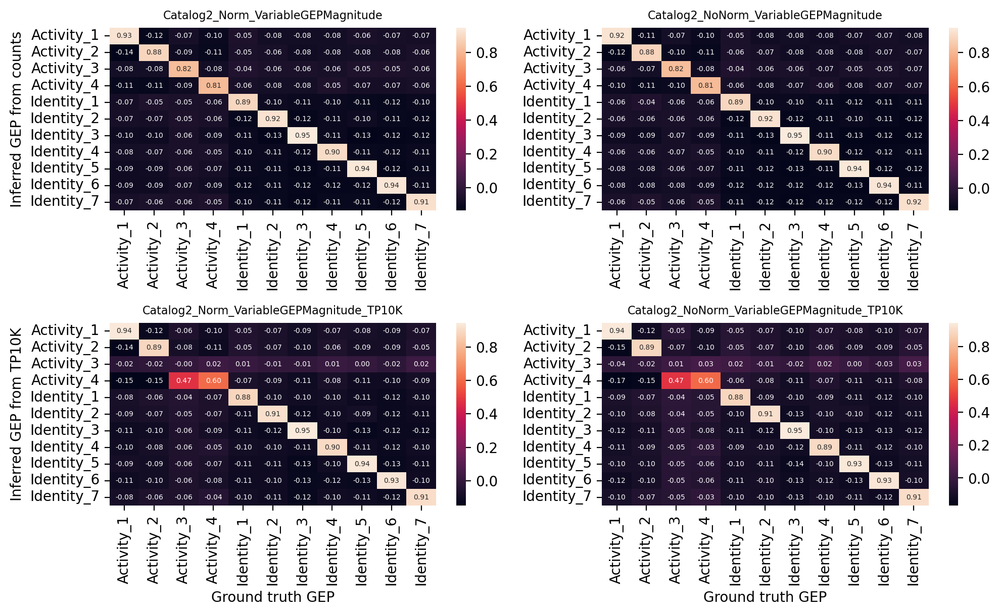

In [51]:
ks = ['Catalog2_Norm_VariableGEPMagnitude', 'Catalog2_NoNorm_VariableGEPMagnitude', 'Catalog2_Norm_VariableGEPMagnitude_TP10K', 'Catalog2_NoNorm_VariableGEPMagnitude_TP10K']
(fig,axes) = plt.subplots(2,2, figsize=(10, 6), dpi=200)
axes[1, 0].set_xlabel('Ground truth GEP')
axes[1, 1].set_xlabel('Ground truth GEP')

axes = axes.ravel()


for i,k in enumerate(ks):
    U = all_results[k]['usage']
    R = df_col_corr(U, simmod_catalog.usage.loc[U.index,:].sort_index(axis=1))
    sns.heatmap(R, ax=axes[i], annot=True, fmt='.2f', annot_kws={'fontsize':5},)
    axes[i].set_title(k, fontsize=8)
    
    
plt.tight_layout()
axes[0].set_ylabel('Inferred GEP from counts')
axes[2].set_ylabel('Inferred GEP from TP10K')
axes[2].set_xlabel('Ground truth GEP')
axes[3].set_xlabel('Ground truth GEP')

# Repeat with multiple seeds and simulations


In [4]:
datadir = '../../Data/TCAT_Simulation_NormTPM/Systematic'
if not os.path.exists(datadir): os.mkdir(datadir)

Simulating gene params
Simulating DE
['Identity_1', 'Identity_2', 'Identity_3', 'Identity_4', 'Identity_5', 'Identity_6', 'Identity_7', 'Activity_1', 'Activity_2', 'Activity_3', 'Activity_4']
Simulating cells
Simulating doublets
Simulating cell-gene means
Adjusting means
Simulating counts


Identity_1    666.768444
Identity_2    705.140516
Identity_3    683.014747
Identity_4    706.150518
Identity_5    686.655899
Identity_6    703.296406
Identity_7    715.108948
Activity_1    882.743258
Activity_2    947.841488
Activity_3    698.426898
Activity_4    776.381675
dtype: float64

/tmp/ipykernel_2842/2848237534.py:44: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
/PHShome/dk718/.conda/envs/py38_r411/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


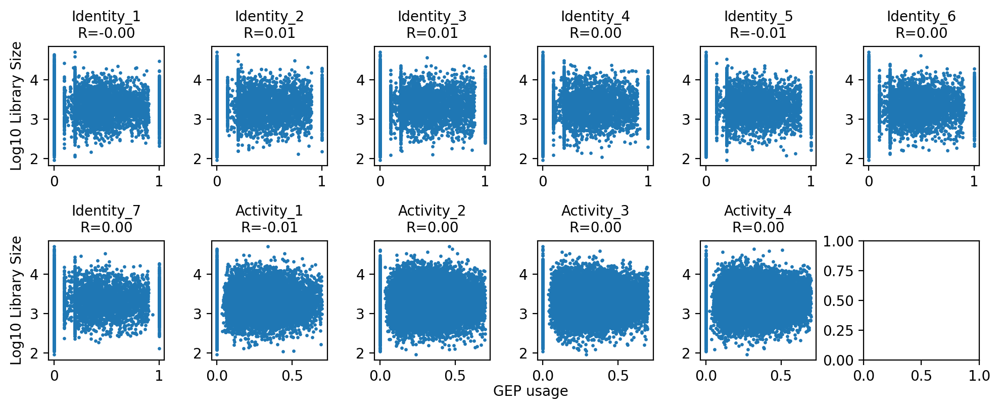

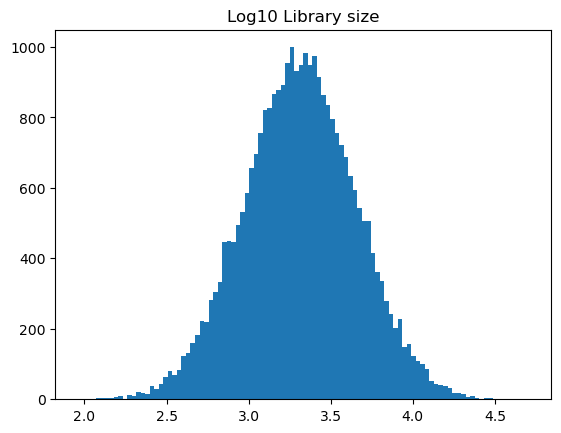

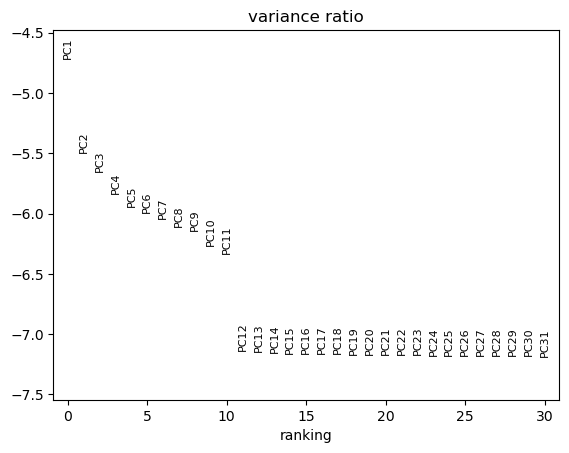

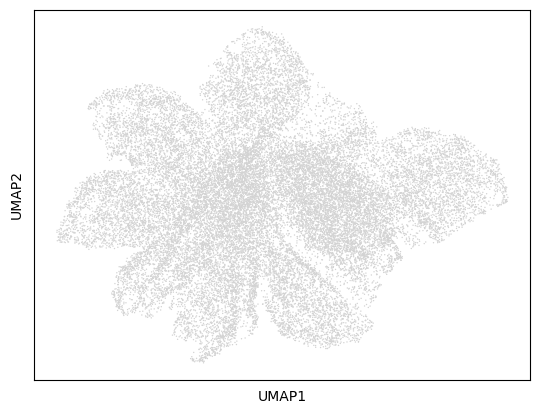

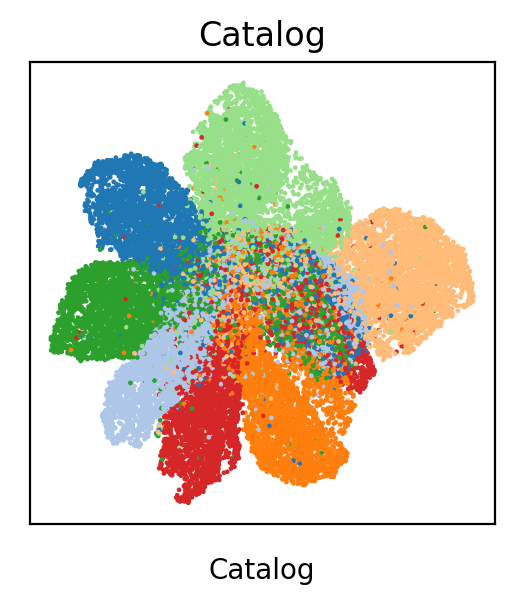

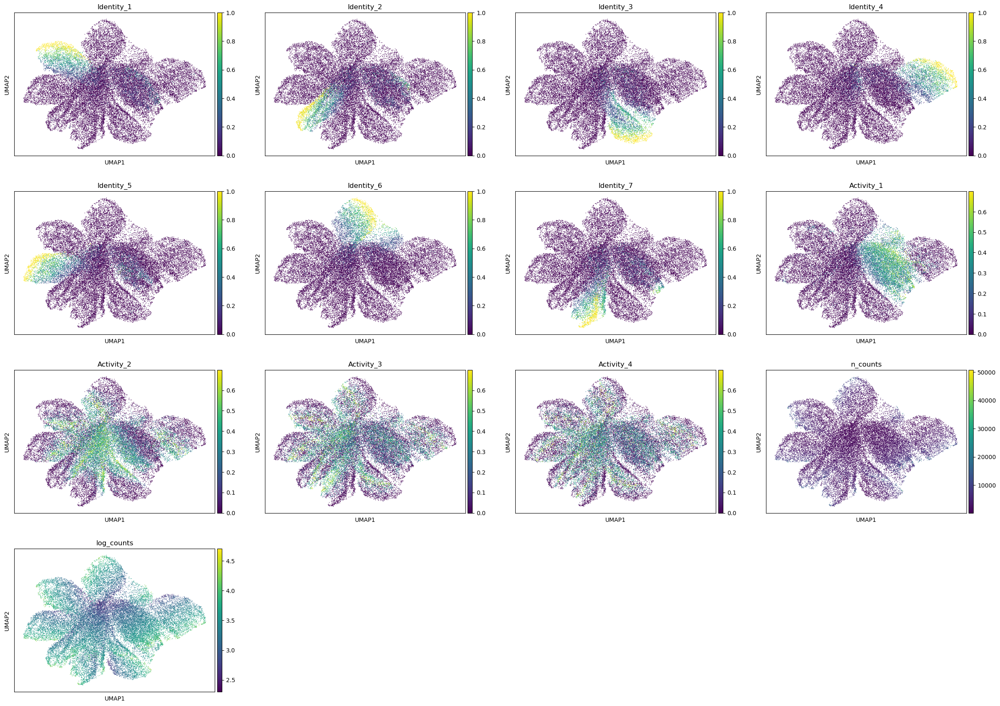

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

Identity_1    669.398741
Identity_2    657.502215
Identity_3    671.463061
Identity_4    651.050741
Identity_5    677.083827
Identity_6    741.337244
Identity_7    645.712123
Activity_1    765.960472
Activity_2    759.870591
Activity_3    659.326933
Activity_4    748.329426
dtype: float64

/tmp/ipykernel_2842/2848237534.py:44: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
/PHShome/dk718/.conda/envs/py38_r411/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


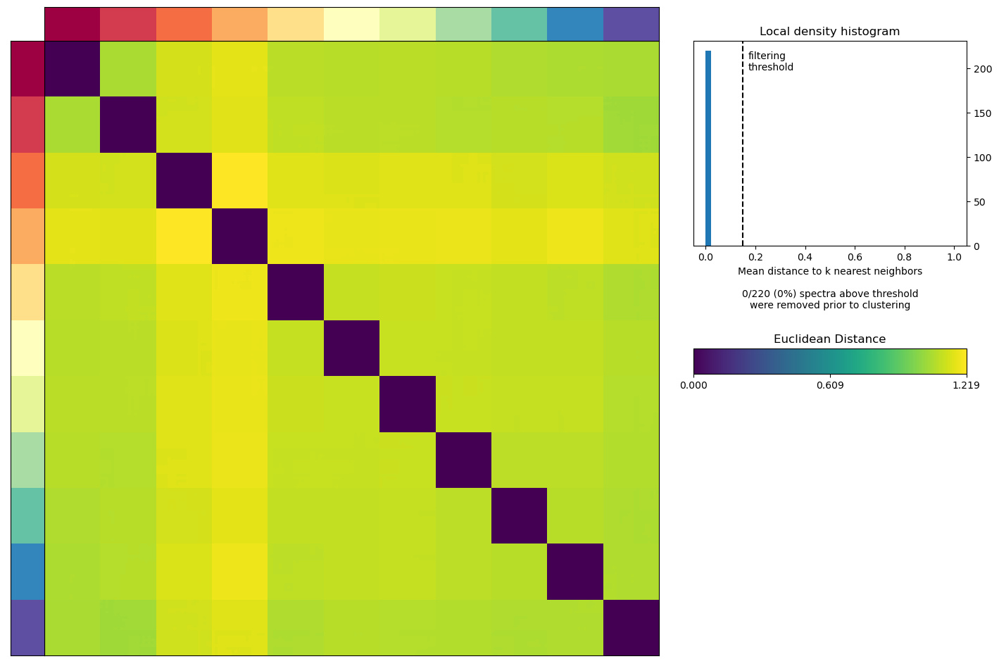

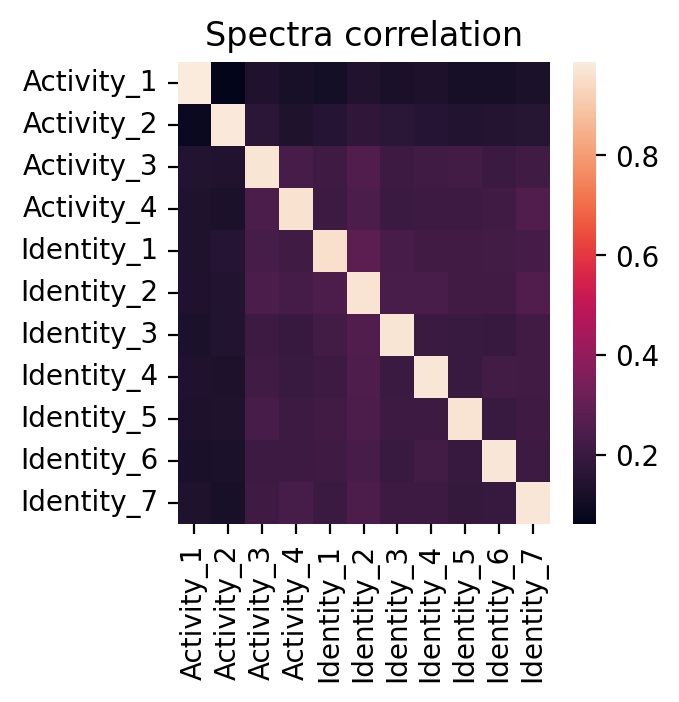

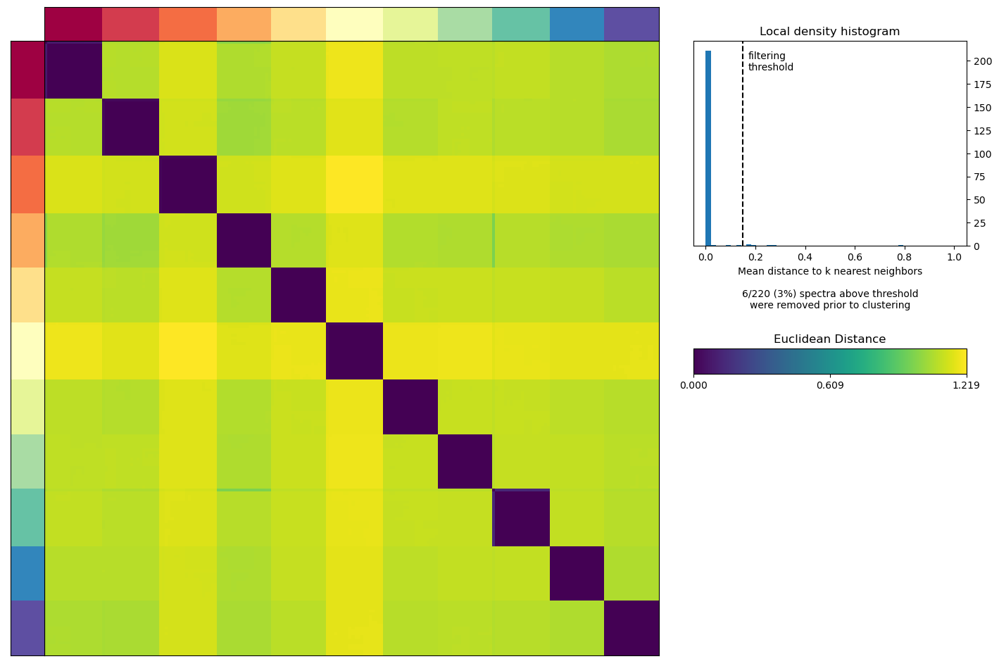

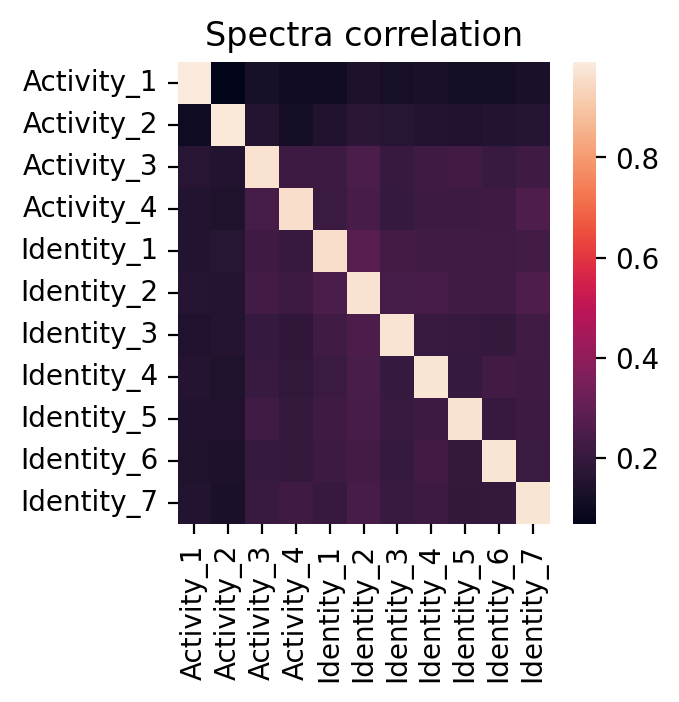

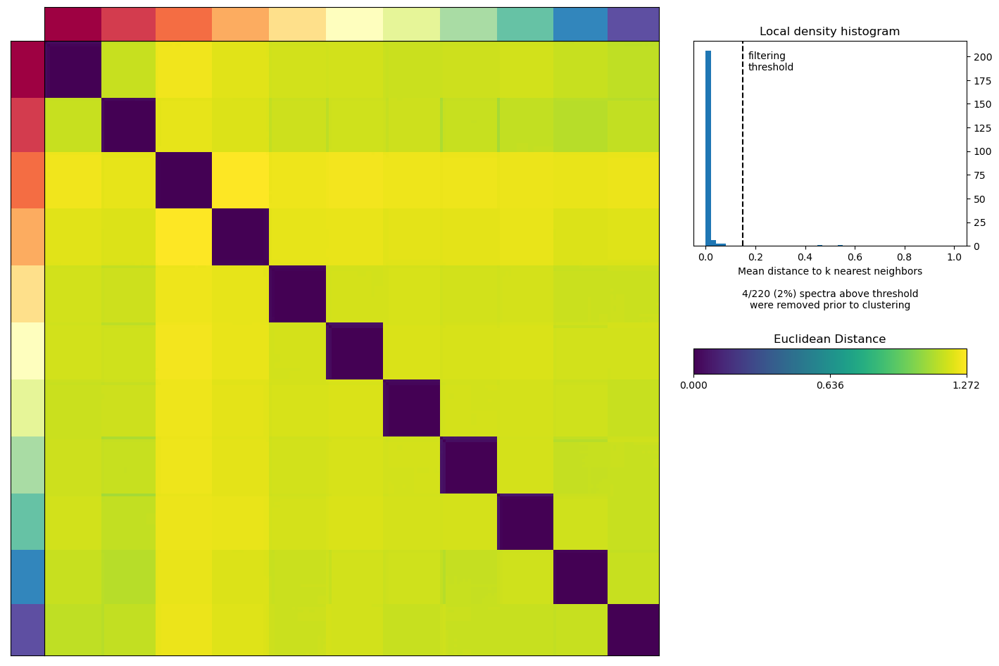

...

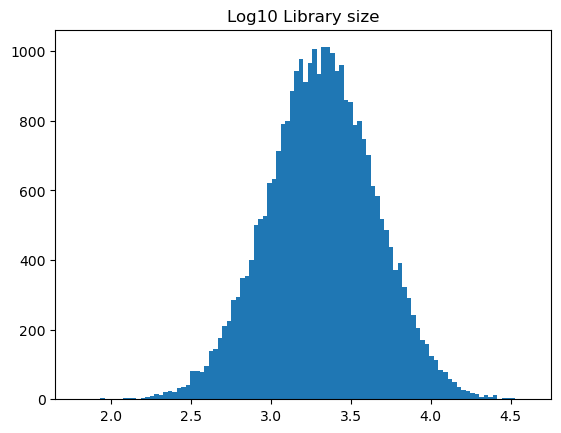

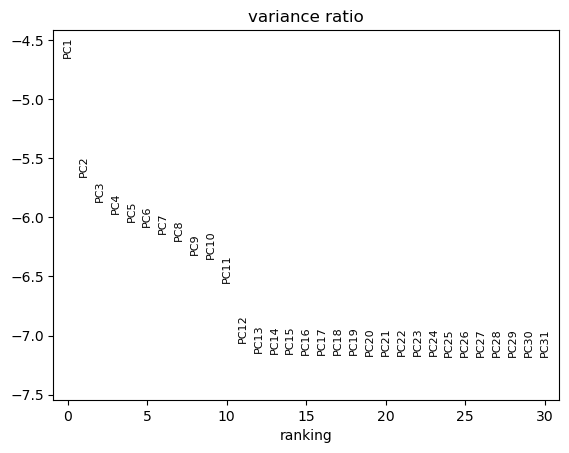

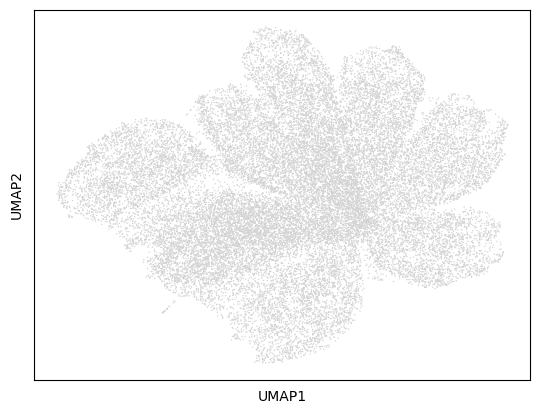

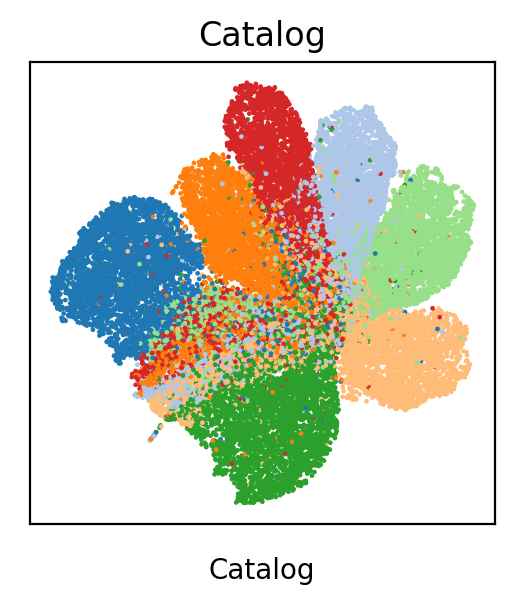

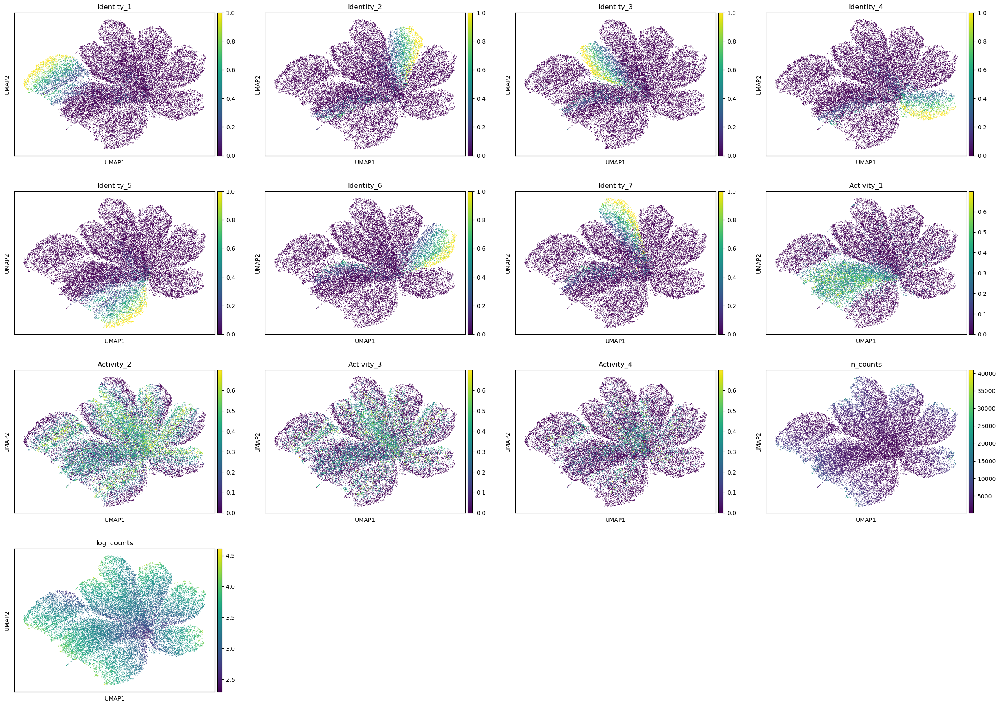

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

Identity_1    629.966308
Identity_2    635.543923
Identity_3    618.755751
Identity_4    628.766806
Identity_5    662.271842
Identity_6    629.625428
Identity_7    622.297540
Activity_1    735.224962
Activity_2    801.731620
Activity_3    649.522876
Activity_4    633.588129
dtype: float64

/tmp/ipykernel_2842/2848237534.py:44: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
/PHShome/dk718/.conda/envs/py38_r411/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


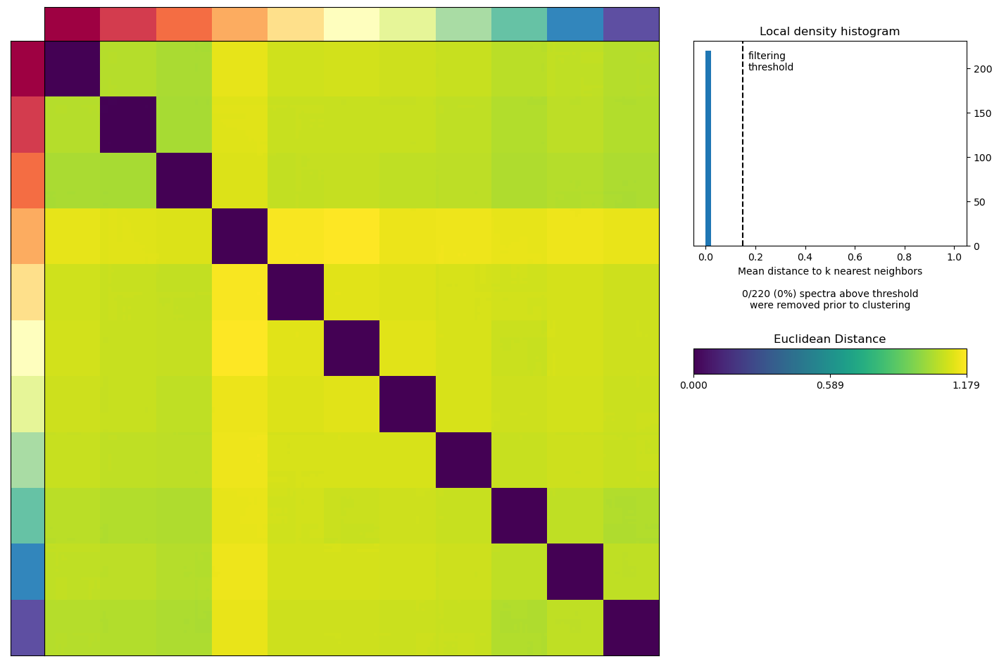

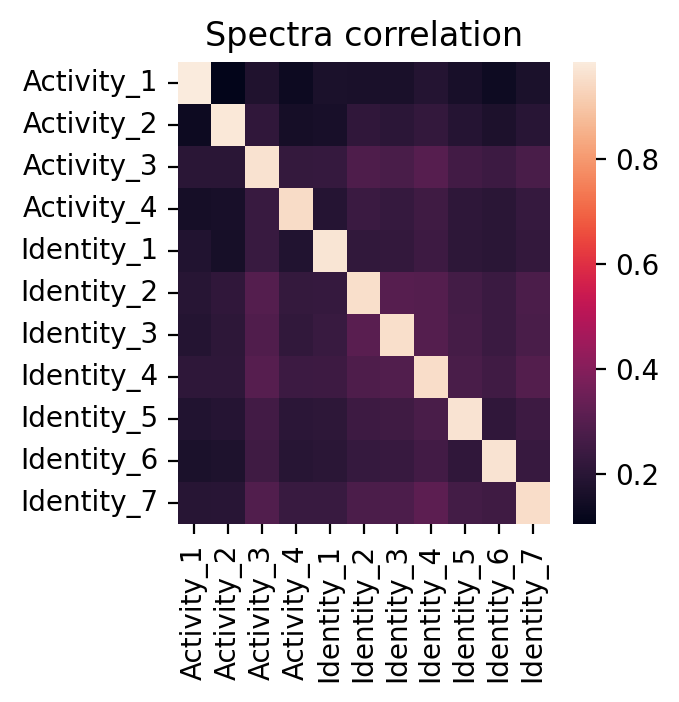

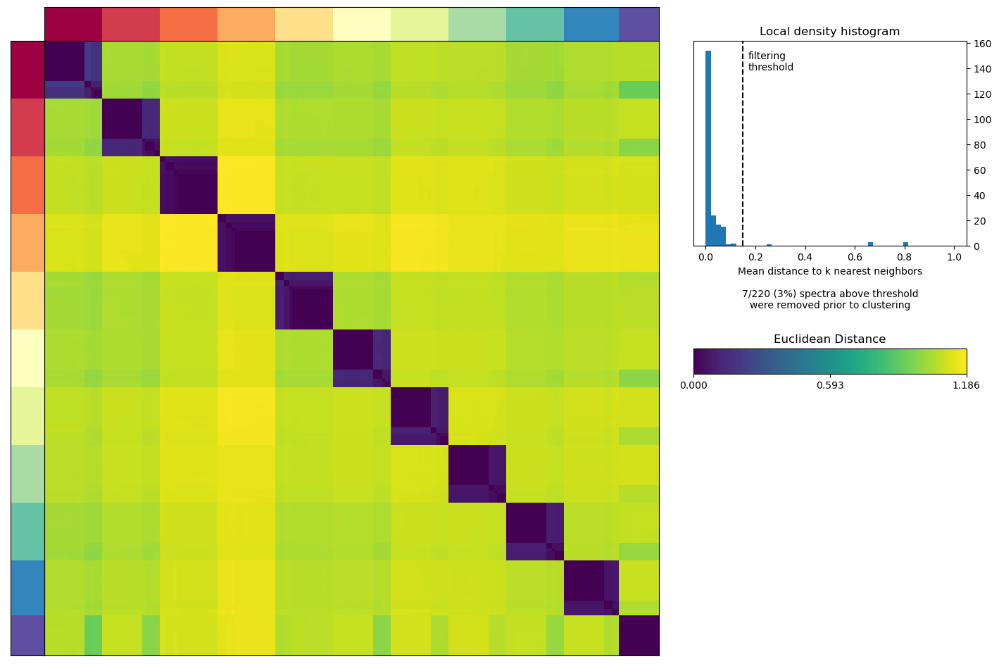

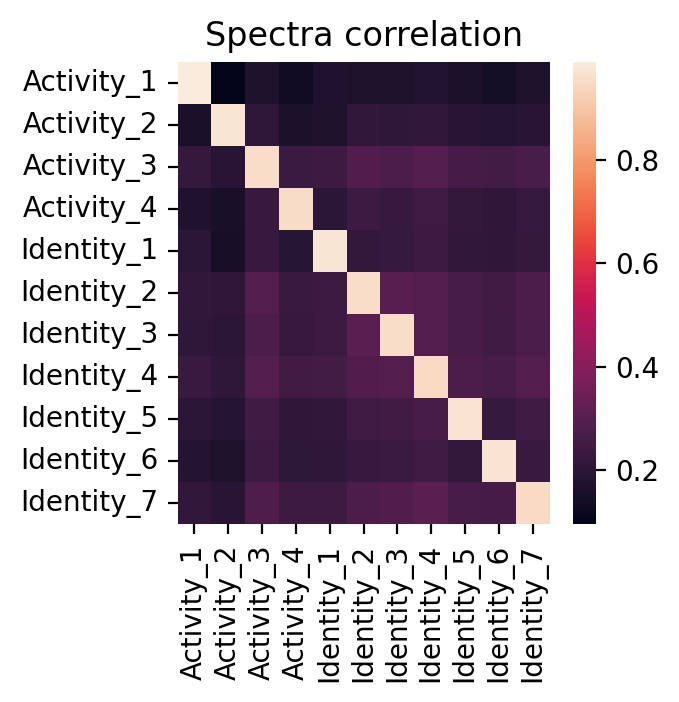

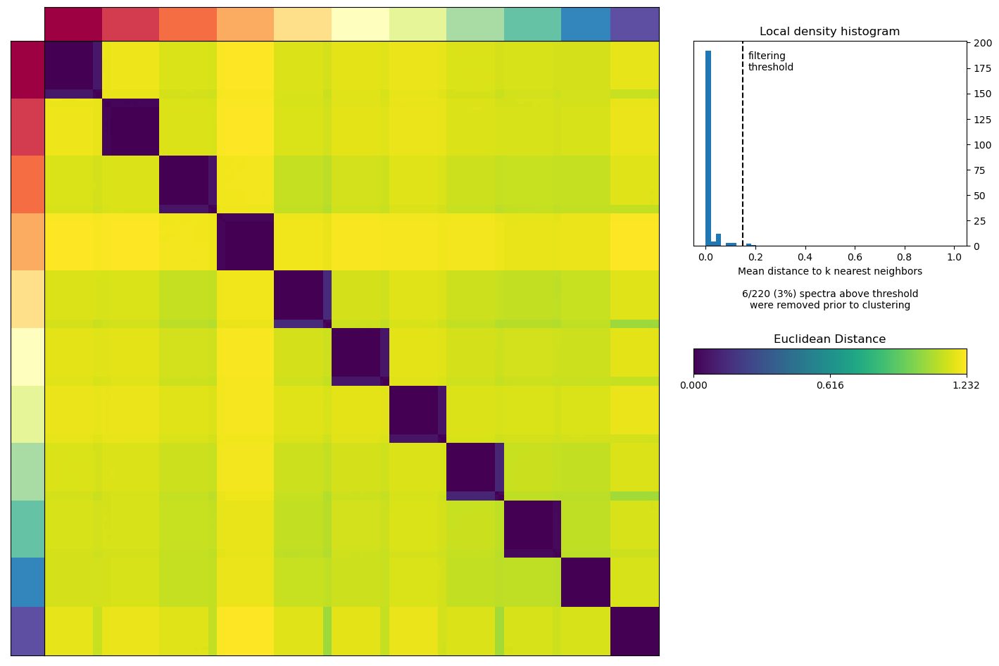

...

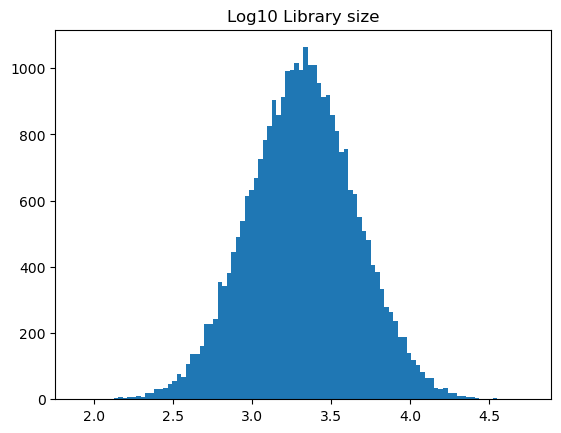

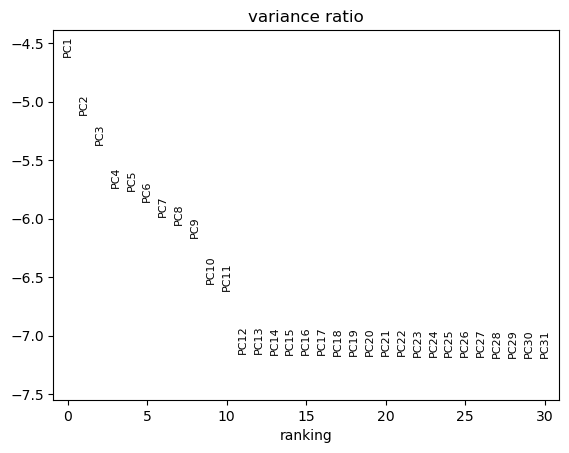

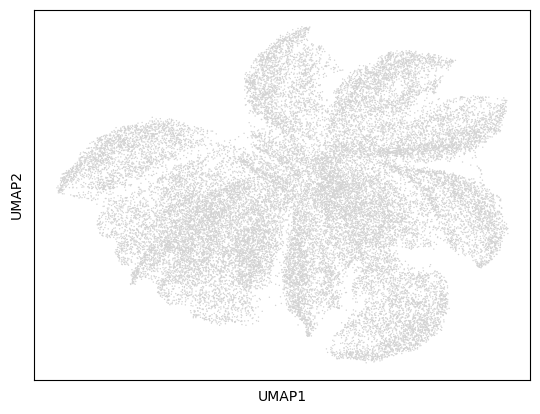

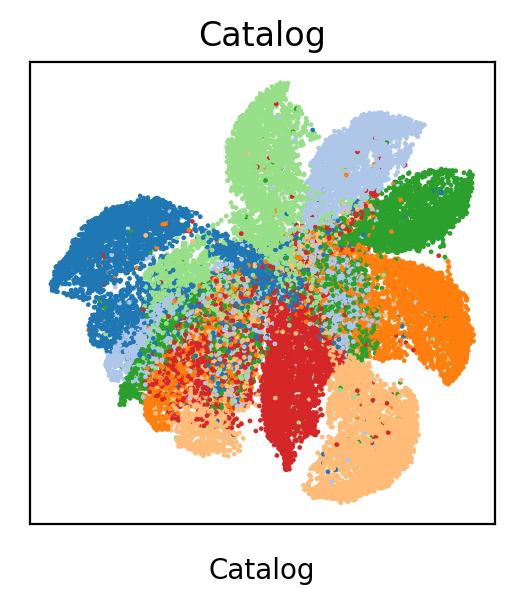

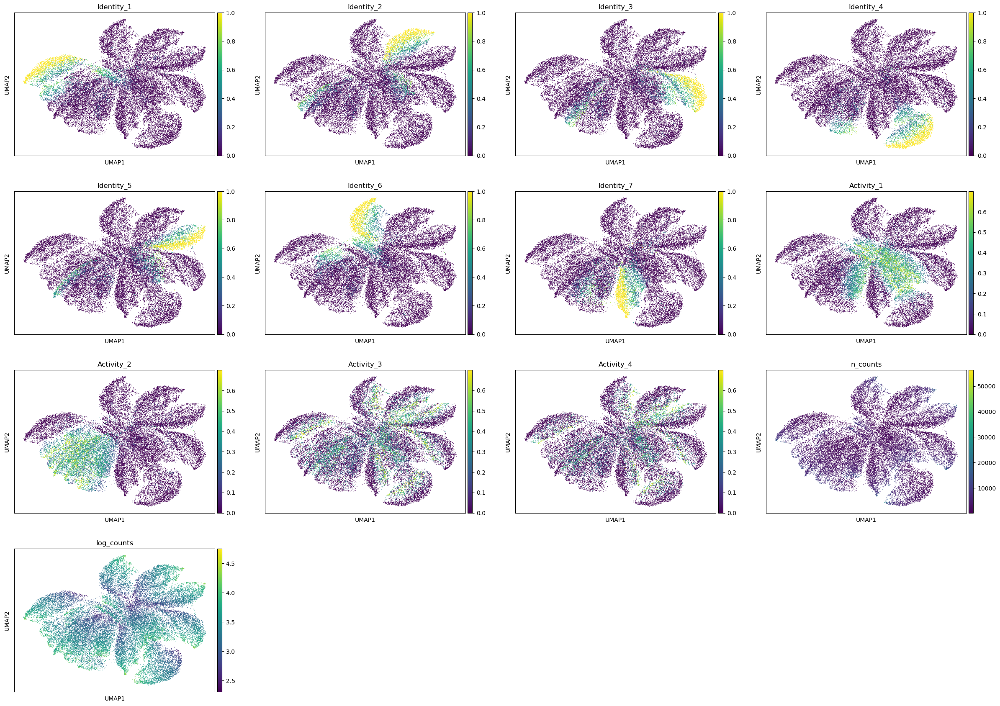

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

/tmp/ipykernel_2842/2848237534.py:69: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()


Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.counts', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.tpm', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
Only considering the two last: ['.norm_counts', '.h5ad'].
[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Star

In [ ]:
all_results = {}
np.random.seed(56)
niter = 10
deprob = [.025]*7 + [.1]*2 + [.025]*2
adatas = {}
for delta_range_libloc in [0, .1, .25]:
    for delocval in [1, 1.25]:
        seeds = np.random.choice(100000, size=niter, replace=False)
        for i, seed in enumerate(seeds):
            deloc = [delocval]*11
            simmod_catalog = SCsim_DiffScale(seed=seed)
            simmod_catalog.simulate(ncells=30000, ngenes=10000, nidentities=7, activity_pct=[.3]*4,
                        activity_min=[.1]*4, activity_max=[.7]*4,
                        activity_identities=[list(range(1,8))]*4,
                        pct_doublets=.05, diffexploc=deloc, diffexpscale=1, diffexpprob=deprob,
                        delta_range_libloc=delta_range_libloc)
            display(simmod_catalog.spectra.sum(axis=1))

            libsize = simmod_catalog.counts.sum(axis=1)
            libsize_log = libsize.apply(np.log10)
            (fig,axes) = plt.subplots(2, 6, figsize=(10,4), dpi=200)
            axes[0,0].set_ylabel('Log10 Library Size')
            axes[1,0].set_ylabel('Log10 Library Size')
            plt.figtext(.53, 0, 'GEP usage', va='bottom', ha='center')
            axes = axes.ravel()

            for (i,a) in enumerate(axes):
                if i > 10:
                    break

                a.scatter(simmod_catalog.usage.iloc[:,i], libsize_log, s=2)
                R,P = pearsonr(simmod_catalog.usage.iloc[:,i], libsize_log)
                a.set_title(simmod_catalog.usage.columns[i] + '\nR=%.2f' % R, fontsize=10)

            plt.tight_layout()

            plt.figure()
            _ = plt.hist(libsize.apply(np.log10), bins=100)
            plt.title('Log10 Library size')


            identity_map = dict(zip(np.arange(1,12), sns.color_palette("tab20")))
            for (data, label) in [(simmod_catalog, 'Catalog')]:
                a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
                a = process_log(a)

                umap = pd.DataFrame(a.obsm['X_umap'], index=a.obs.index, columns=['U1', 'U2'])
                umap['identity'] = data.cellparams['Identity']
                umap['color'] = umap['identity'].apply(lambda x: identity_map[x])

                (fig,ax) = plt.subplots(1,1, figsize=(3,3), dpi=200)
                ax.scatter(umap['U1'], umap['U2'], c=umap['color'], s=.5)
                ax.set_xticks([])
                ax.set_yticks([])
                ax.set_title(label)
                ax.text(.5,-0.1,label, ha='center', va='center', transform=ax.transAxes)
            a.obs['log_counts'] = a.obs['n_counts'].apply(np.log10)
            sc.pl.umap(a, color=a.obs.columns)
            adatas[(delta_range_libloc, delocval, seed)] = a



            ldthresh = 0.15
            K = simmod_catalog.usage.shape[1]
            for (data, label, normalize_tpm_spectra, use_tp10k) in [(simmod_catalog, 'deloc%.2f_Seed%d_drange%.2f_Norm_VariableGEPMagnitude' % (delocval, seed, delta_range_libloc), True, False),
                                                                    (simmod_catalog, 'deloc%.2f_Seed%d_drange%.2f_NoNorm_VariableGEPMagnitude' % (delocval, seed, delta_range_libloc), False, False),
                                                                (simmod_catalog, 'deloc%.2f_Seed%d_drange%.2f_Norm_VariableGEPMagnitude_TP10K' % (delocval, seed, delta_range_libloc), True, True),
                                                                    (simmod_catalog, 'deloc%.2f_Seed%d_drange%.2f_NoNorm_VariableGEPMagnitude_TP10K' % (delocval, seed, delta_range_libloc), False, True)]:
                a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()
                sc.pp.filter_genes(a, min_cells=5)
                sc.pp.filter_cells(a, min_counts=200)

                if use_tp10k:
                    sc.pp.normalize_per_cell(a, counts_per_cell_after=1e4)

                countfn = '{d}/{lab}.counts.h5ad'.format(d=datadir, lab=label)
                sc.write(countfn, a)
                data.geneparams.to_csv('{d}/{lab}.geneparams.tsv'.format(d=datadir, lab=label), sep='\t')
                cnmf_obj = cNMF(output_dir=datadir, name=label)
                cnmf_obj.prepare(counts_fn=countfn, components=K, n_iter=20, seed=np.random.choice(100000, size=1), num_highvar_genes=2000)
                cnmf_obj.factorize()
                cnmf_obj.combine()
                cnmf_obj.consensus(k=K, density_threshold=ldthresh, show_clustering=True, refit_usage=True, normalize_tpm_spectra=normalize_tpm_spectra)

                res = load_and_relabel(cnmf_obj, data.spectra, K=K, ldthresh=ldthresh)
                all_results[label] = res


            ks = ['deloc%.2f_Seed%d_drange%.2f_Norm_VariableGEPMagnitude' % (delocval, seed, delta_range_libloc), 'deloc%.2f_Seed%d_drange%.2f_NoNorm_VariableGEPMagnitude' % (delocval, seed, delta_range_libloc),
                  'deloc%.2f_Seed%d_drange%.2f_Norm_VariableGEPMagnitude_TP10K' % (delocval, seed, delta_range_libloc), 'deloc%.2f_Seed%d_drange%.2f_NoNorm_VariableGEPMagnitude_TP10K' % (delocval, seed, delta_range_libloc)]
            (fig,axes) = plt.subplots(2,2, figsize=(10, 6), dpi=200)
            axes[1, 0].set_xlabel('Ground truth GEP')
            axes[1, 1].set_xlabel('Ground truth GEP')

            axes = axes.ravel()


            for i,k in enumerate(ks):
                U = all_results[k]['usage']
                R = df_col_corr(U, simmod_catalog.usage.loc[U.index,:].sort_index(axis=1))
                sns.heatmap(R, ax=axes[i], annot=True, fmt='.2f', annot_kws={'fontsize':5},)
                axes[i].set_title(k, fontsize=8)


            plt.tight_layout()
            axes[0].set_ylabel('Inferred GEP from counts')
            axes[2].set_ylabel('Inferred GEP from TP10K')
            axes[2].set_xlabel('Ground truth GEP')
            axes[3].set_xlabel('Ground truth GEP')

In [10]:
for k in adatas.keys():
    adatas[k].raw = None
    adatas[k].X = None

In [11]:
resultsfn = os.path.join(datadir, 'alladata_sim1.pkl')
with open(resultsfn, 'wb') as handle:
    pickle.dump(adatas, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [12]:
resultsfn = os.path.join(datadir, 'allresults_sim1.pkl')
with open(resultsfn, 'wb') as handle:
    pickle.dump(all_results, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [24]:
resultsfn = os.path.join(datadir, 'alladata_sim1.pkl')
with open(resultsfn, 'rb') as handle:
    adatas = pickle.load(handle)

In [25]:
resultsfn = os.path.join(datadir, 'allresults_sim1.pkl')
with open(resultsfn, 'rb') as handle:
    all_results = pickle.load(handle)

In [26]:
allres = []
for k in all_results.keys():
    deloc = float(k.split('_')[0].replace('deloc', ''))
    seed = int(k.split('_')[1].replace('Seed', ''))
    drange = float(k.split('_')[2].replace('drange', ''))
    specnorm = k.split('_')[3]=='Norm'
    tpm = 'TP10K' in k
    U = all_results[k]['usage']
    R = df_col_corr(U, adatas[(drange, deloc, seed)].obs.loc[U.index, U.columns])
    for i in R.index:
        allres.append([k, deloc, seed, drange, specnorm, tpm, i, R.at[i,i]])
        
allres = pd.DataFrame(allres, columns=['key', 'deloc', 'seed', 'drange', 'specnorm', 'tpm', 'GEP', 'R'])
allres.index = allres['key']
allres = allres.drop('key', axis=1)

In [27]:

allres['Condition'] = allres['specnorm'].replace({True:'NormedSpec', False:'UnnormedSpec'}) + '_' + allres['tpm'].replace({True:'TPMData', False:'CountData'}) 
allres.head()


,deloc,seed,drange,specnorm,tpm,GEP,R,Condition
key,,,,,,,,
deloc1.00_Seed39453_drange0.00_Norm_VariableGEPMagnitude,1.0,39453,0.0,True,False,Activity_1,0.938504,NormedSpec_CountData
deloc1.00_Seed39453_drange0.00_Norm_VariableGEPMagnitude,1.0,39453,0.0,True,False,Activity_2,0.915022,NormedSpec_CountData
deloc1.00_Seed39453_drange0.00_Norm_VariableGEPMagnitude,1.0,39453,0.0,True,False,Activity_3,0.035843,NormedSpec_CountData
deloc1.00_Seed39453_drange0.00_Norm_VariableGEPMagnitude,1.0,39453,0.0,True,False,Activity_4,0.875327,NormedSpec_CountData
deloc1.00_Seed39453_drange0.00_Norm_VariableGEPMagnitude,1.0,39453,0.0,True,False,Identity_1,0.954937,NormedSpec_CountData


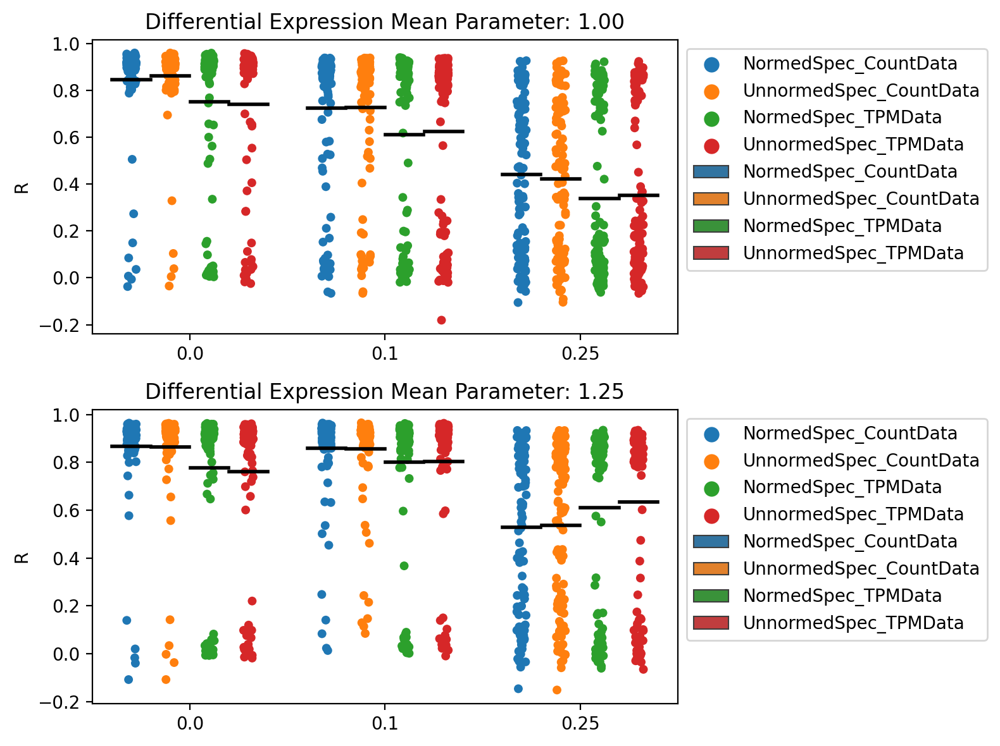

In [18]:
(fig,axes) = plt.subplots(2, 1, figsize=(8,6), dpi=200)
for i,deloc in enumerate([1.0, 1.25]):
    subdat = allres.loc[allres['deloc']==deloc, :]
    sns.stripplot(x='drange', y='R', hue='Condition', data=subdat, dodge=True, ax=axes[i])
    
    sns.boxplot(x='drange', y='R', hue='Condition', data=subdat, showmeans=True,
            meanline=True,
            meanprops={'color': 'k', 'ls': '-', 'lw': 2},
            medianprops={'visible': False},
            whiskerprops={'visible': False},
            zorder=10,
            showfliers=False,
            showbox=False,
            showcaps=False,
            ax=axes[i])
    axes[i].legend(bbox_to_anchor=(1,1))
    
    if i == 2:
        axes[i].set_xlabel('Log-scale delta in library size with GEP usage')
    else:
        axes[i].set_xlabel('')
        
    axes[i].set_title('Differential Expression Mean Parameter: %.2f' % deloc)
    
    
plt.tight_layout()

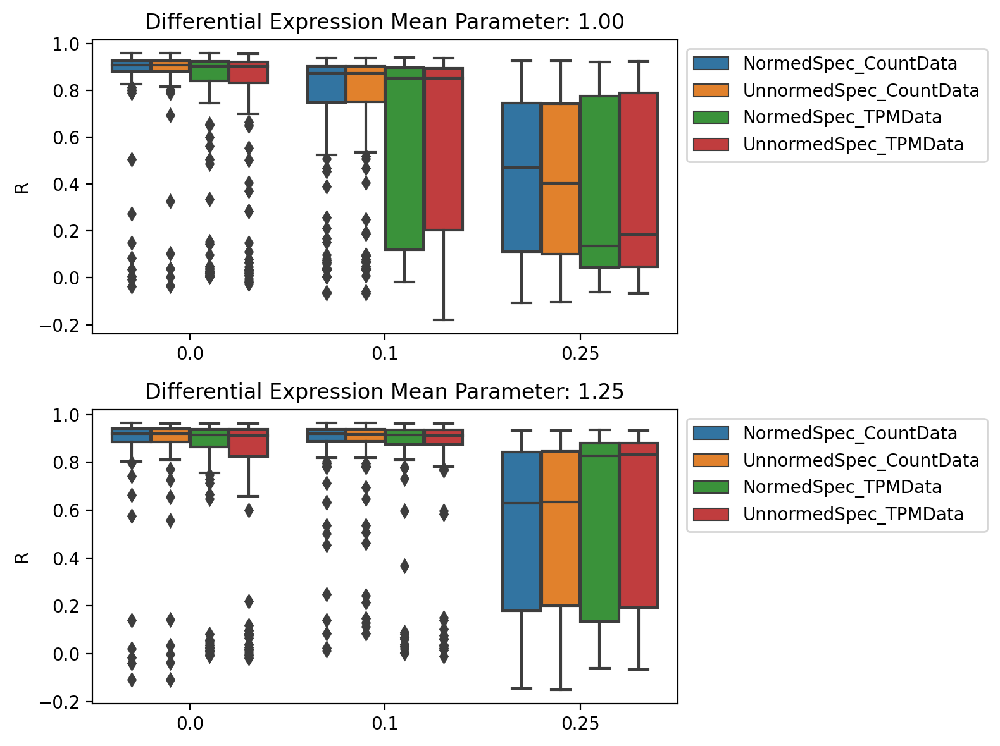

In [19]:
(fig,axes) = plt.subplots(2, 1, figsize=(8,6), dpi=200)
for i,deloc in enumerate([1.0, 1.25]):
    ind = (allres['deloc']==deloc)
    subdat = allres.loc[ind, :]
    sns.boxplot(x='drange', y='R', hue='Condition', data=subdat, dodge=True, ax=axes[i])
    axes[i].legend(bbox_to_anchor=(1,1))
    if i == 2:
        axes[i].set_xlabel('Log-scale delta in library size with GEP usage')
    else:
        axes[i].set_xlabel('')
        
    axes[i].set_title('Differential Expression Mean Parameter: %.2f' % deloc)
    
    
plt.tight_layout()

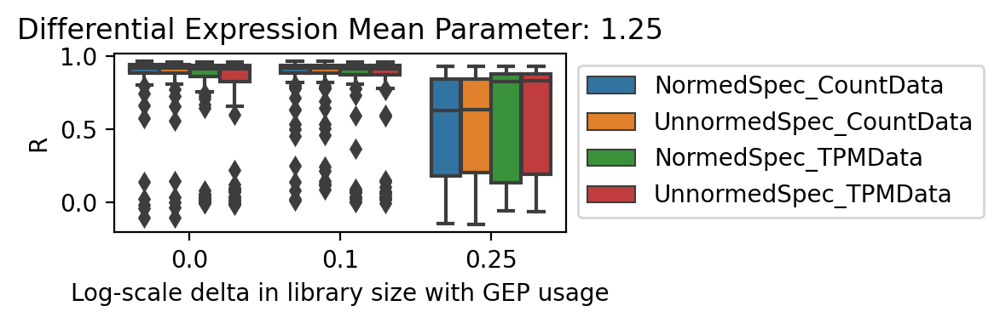

In [20]:
(fig,ax) = plt.subplots(1, 1, figsize=(6,2), dpi=200)
deloc = 1.25
ind = (allres['deloc']==deloc)
subdat = allres.loc[ind, :]
sns.boxplot(x='drange', y='R', hue='Condition', data=subdat, dodge=True, ax=ax)
ax.legend(bbox_to_anchor=(1,1))
ax.set_xlabel('Log-scale delta in library size with GEP usage')
ax.set_title('Differential Expression Mean Parameter: %.2f' % deloc)
    
    
plt.tight_layout()

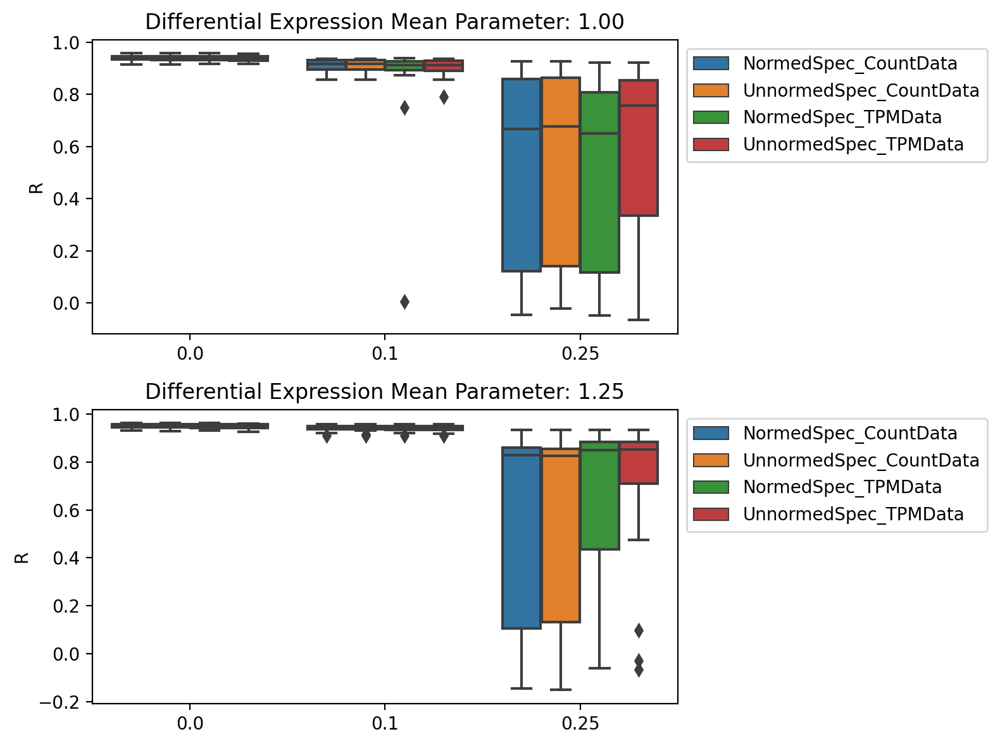

In [23]:
(fig,axes) = plt.subplots(2, 1, figsize=(8,6), dpi=200)
for i,deloc in enumerate([1.0, 1.25]):
    ind = (allres['deloc']==deloc) & allres['GEP'].isin(['Activity_1', 'Activity_2'])
    subdat = allres.loc[ind, :]
    sns.boxplot(x='drange', y='R', hue='Condition', data=subdat, dodge=True, ax=axes[i])
    axes[i].legend(bbox_to_anchor=(1,1))
    if i == 2:
        axes[i].set_xlabel('Log-scale delta in library size with GEP usage')
    else:
        axes[i].set_xlabel('')
        
    axes[i].set_title('Differential Expression Mean Parameter: %.2f' % deloc)
    
    
plt.tight_layout()

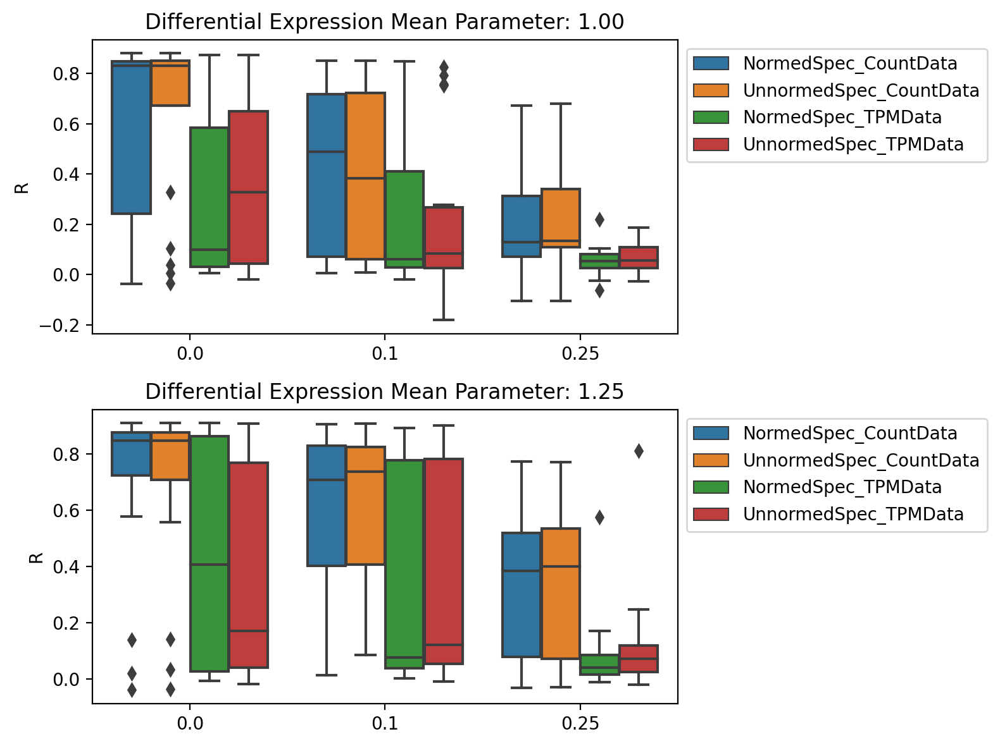

In [24]:
(fig,axes) = plt.subplots(2, 1, figsize=(8,6), dpi=200)
for i,deloc in enumerate([1.0, 1.25]):
    ind = (allres['deloc']==deloc) & allres['GEP'].isin(['Activity_3', 'Activity_4'])
    subdat = allres.loc[ind, :]
    sns.boxplot(x='drange', y='R', hue='Condition', data=subdat, dodge=True, ax=axes[i])
    axes[i].legend(bbox_to_anchor=(1,1))
    if i == 2:
        axes[i].set_xlabel('Log-scale delta in library size with GEP usage')
    else:
        axes[i].set_xlabel('')
        
    axes[i].set_title('Differential Expression Mean Parameter: %.2f' % deloc)
    
    
plt.tight_layout()

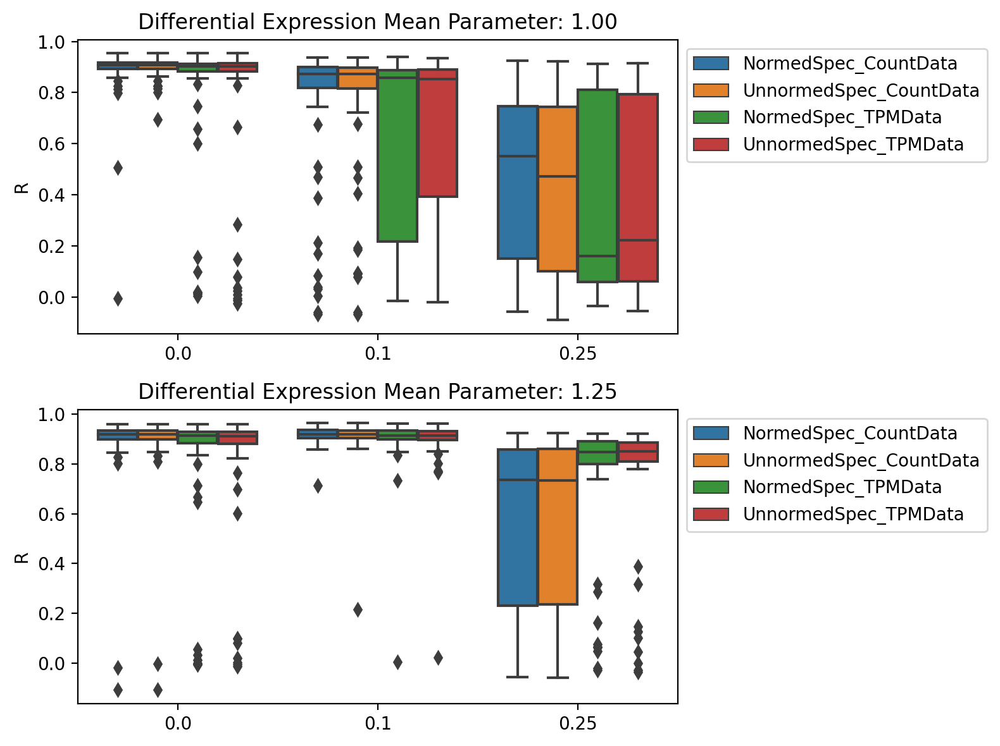

In [25]:
(fig,axes) = plt.subplots(2, 1, figsize=(8,6), dpi=200)
for i,deloc in enumerate([1.0, 1.25]):
    ind = (allres['deloc']==deloc) & ~allres['GEP'].isin(['Activity_1', 'Activity_2', 'Activity_3', 'Activity_4'])
    subdat = allres.loc[ind, :]
    sns.boxplot(x='drange', y='R', hue='Condition', data=subdat, dodge=True, ax=axes[i])
    axes[i].legend(bbox_to_anchor=(1,1))
    if i == 2:
        axes[i].set_xlabel('Log-scale delta in library size with GEP usage')
    else:
        axes[i].set_xlabel('')
        
    axes[i].set_title('Differential Expression Mean Parameter: %.2f' % deloc)
    
    
plt.tight_layout()

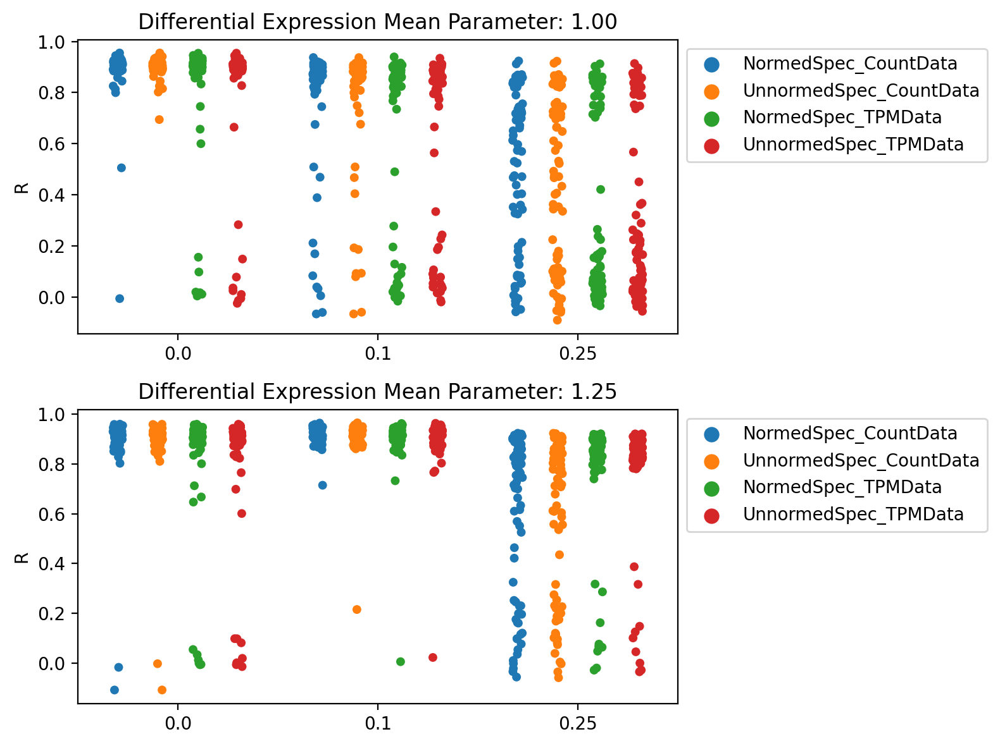

In [26]:
(fig,axes) = plt.subplots(2, 1, figsize=(8,6), dpi=200)
for i,deloc in enumerate([1.0, 1.25]):
    ind = (allres['deloc']==deloc) & ~allres['GEP'].isin(['Activity_1', 'Activity_2', 'Activity_3', 'Activity_4'])
    subdat = allres.loc[ind, :]
    sns.stripplot(x='drange', y='R', hue='Condition', data=subdat, dodge=True, ax=axes[i])
    axes[i].legend(bbox_to_anchor=(1,1))
    if i == 2:
        axes[i].set_xlabel('Log-scale delta in library size with GEP usage')
    else:
        axes[i].set_xlabel('')
        
    axes[i].set_title('Differential Expression Mean Parameter: %.2f' % deloc)
    
    
plt.tight_layout()

# Example plots

In [33]:
ind = (allres['deloc']==1.0) & (allres['drange']==0.25)
allres.loc[ind, :]

,deloc,seed,drange,specnorm,tpm,GEP,R,Condition
key,,,,,,,,
deloc1.00_Seed63897_drange0.25_Norm_VariableGEPMagnitude,1.0,63897,0.25,True,False,Activity_1,0.926253,NormedSpec_CountData
deloc1.00_Seed63897_drange0.25_Norm_VariableGEPMagnitude,1.0,63897,0.25,True,False,Activity_2,0.073654,NormedSpec_CountData
deloc1.00_Seed63897_drange0.25_Norm_VariableGEPMagnitude,1.0,63897,0.25,True,False,Activity_3,0.671083,NormedSpec_CountData
deloc1.00_Seed63897_drange0.25_Norm_VariableGEPMagnitude,1.0,63897,0.25,True,False,Activity_4,0.029350,NormedSpec_CountData
deloc1.00_Seed63897_drange0.25_Norm_VariableGEPMagnitude,1.0,63897,0.25,True,False,Identity_1,0.859119,NormedSpec_CountData
...,...,...,...,...,...,...,...,...
deloc1.00_Seed92965_drange0.25_NoNorm_VariableGEPMagnitude_TP10K,1.0,92965,0.25,False,True,Identity_3,0.247618,UnnormedSpec_TPMData
deloc1.00_Seed92965_drange0.25_NoNorm_VariableGEPMagnitude_TP10K,1.0,92965,0.25,False,True,Identity_4,0.242640,UnnormedSpec_TPMData
deloc1.00_Seed92965_drange0.25_NoNorm_VariableGEPMagnitude_TP10K,1.0,92965,0.25,False,True,Identity_5,-0.018418,UnnormedSpec_TPMData


In [28]:
from matplotlib.pyplot import rc_context


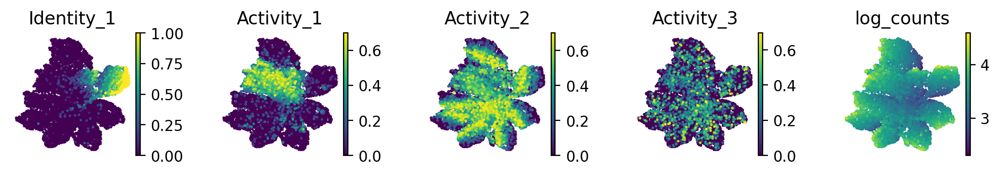

Text(0.5, 0, 'GEP Usage')

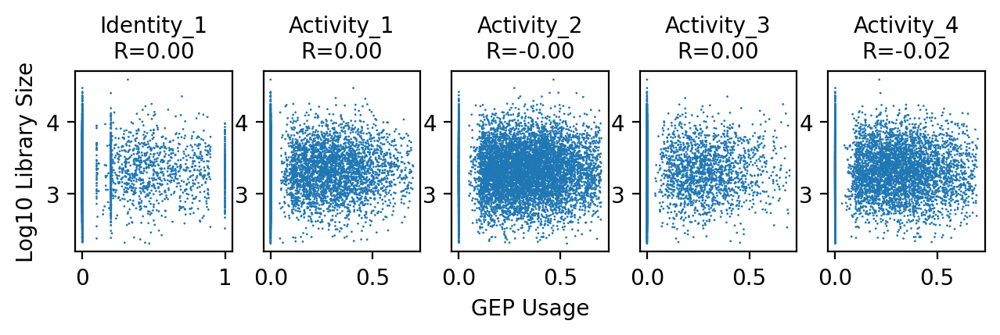

In [32]:
k =(0., 1.0, 39453)
with rc_context({'figure.figsize': (1.5, 1.5), 'figure.dpi':200}):
    sc.pl.umap(adatas[k], color=['Identity_1', 'Activity_1', 'Activity_2', 'Activity_3', 'log_counts'], ncols=5, frameon=False)


toplot = ['Identity_1', 'Activity_1', 'Activity_2', 'Activity_3', 'Activity_4']
(fig,axes) = plt.subplots(1, 5, figsize=(7.5,1.5), dpi=200)
axes[0].set_ylabel('Log10 Library Size')

for (i,a) in enumerate(toplot):
    axes[i].scatter(adatas[k].obs.loc[:,a], adatas[k].obs.loc[:,'log_counts'], s=1, edgecolor='None')
    R,P = pearsonr(adatas[k].obs.loc[:,a], adatas[k].obs.loc[:,'log_counts'])
    axes[i].set_title(a + '\nR=%.2f' % R, fontsize=10)
    
    
axes[2].set_xlabel('GEP Usage')

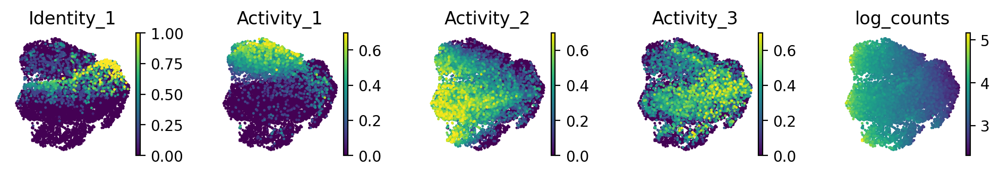

Text(0.5, 0, 'GEP Usage')

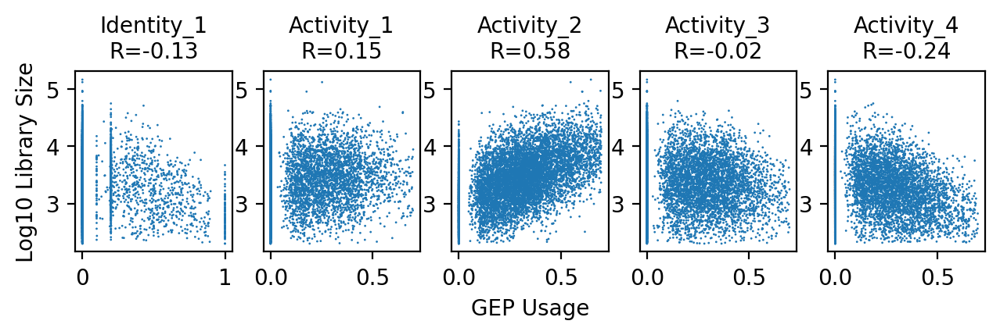

In [35]:
k =(0.25, 1.0, 63897)
with rc_context({'figure.figsize': (1.5, 1.5), 'figure.dpi':200}):
    sc.pl.umap(adatas[k], color=['Identity_1', 'Activity_1', 'Activity_2', 'Activity_3', 'log_counts'], ncols=5, frameon=False)


toplot = ['Identity_1', 'Activity_1', 'Activity_2', 'Activity_3', 'Activity_4']
(fig,axes) = plt.subplots(1, 5, figsize=(7.5,1.5), dpi=200)
axes[0].set_ylabel('Log10 Library Size')

for (i,a) in enumerate(toplot):
    axes[i].scatter(adatas[k].obs.loc[:,a], adatas[k].obs.loc[:,'log_counts'], s=1, edgecolor='None')
    R,P = pearsonr(adatas[k].obs.loc[:,a], adatas[k].obs.loc[:,'log_counts'])
    axes[i].set_title(a + '\nR=%.2f' % R, fontsize=10)
    
    
axes[2].set_xlabel('GEP Usage')

In [96]:
X = allres.groupby(['deloc', 'drange', 'specnorm', 'tpm'])['R'].mean().reset_index()
Y = allres2.groupby(['deloc', 'drange', 'specnorm', 'tpm'])['R'].mean().reset_index().rename(columns={'R':'R2'})
merged = pd.merge(left=X, right=Y, on=['deloc', 'drange', 'specnorm', 'tpm'], how='inner')
merged

,deloc,drange,specnorm,tpm,R,R2
0,1.00,0.00,False,False,0.861985,0.879932
1,1.00,0.00,False,True,0.738960,0.851170
2,1.00,0.00,True,False,0.845962,0.884303
3,1.00,0.00,True,True,0.750455,0.859804
4,1.00,0.10,False,False,0.726556,0.825733
5,1.00,0.10,False,True,0.625477,0.822412
6,1.00,0.10,True,False,0.723586,0.832510
7,1.00,0.10,True,True,0.610707,0.808773
8,1.00,0.25,False,False,0.420753,0.484491
9,1.00,0.25,False,True,0.351026,0.566027


In [97]:
X.pivot_table(index=['deloc', 'drange'], columns=['tpm', 'specnorm'], values='R')

tpm              False                True          
specnorm         False      True     False      True
deloc drange                                        
1.00  0.00    0.861985  0.845962  0.738960  0.750455
      0.10    0.726556  0.723586  0.625477  0.610707
      0.25    0.420753  0.440358  0.351026  0.338981
1.25  0.00    0.865807  0.866349  0.762557  0.777707
      0.10    0.857642  0.859966  0.804836  0.801542
      0.25    0.537894  0.527462  0.634041  0.611645

In [99]:
Y.pivot_table(index=['deloc', 'drange'], columns=['specnorm', 'tpm'], values='R2')

specnorm         False                True          
tpm              False      True     False      True
deloc drange                                        
1.00  0.00    0.879932  0.851170  0.884303  0.859804
      0.10    0.825733  0.822412  0.832510  0.808773
      0.25    0.484491  0.566027  0.467054  0.584323
1.25  0.00    0.930875  0.929573  0.922349  0.929665
      0.10    0.887744  0.882645  0.884985  0.871303
      0.25    0.671173  0.736339  0.692059  0.720310

In [100]:
Y.pivot_table(index=['deloc', 'drange'], columns=['tpm', 'specnorm'], values='R2')

tpm              False                True          
specnorm         False      True     False      True
deloc drange                                        
1.00  0.00    0.879932  0.884303  0.851170  0.859804
      0.10    0.825733  0.832510  0.822412  0.808773
      0.25    0.484491  0.467054  0.566027  0.584323
1.25  0.00    0.930875  0.922349  0.929573  0.929665
      0.10    0.887744  0.884985  0.882645  0.871303
      0.25    0.671173  0.692059  0.736339  0.720310

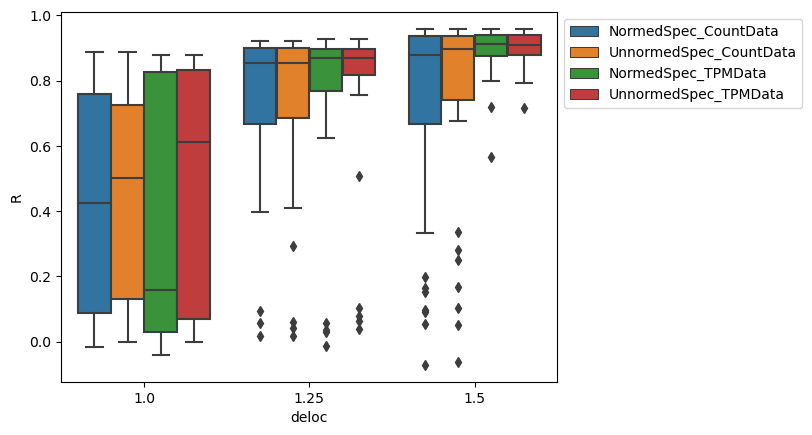

In [81]:
ax = sns.boxplot(x='deloc', y='R', hue='Condition', data=allres, dodge=True)
ax.legend(bbox_to_anchor=(1,1))

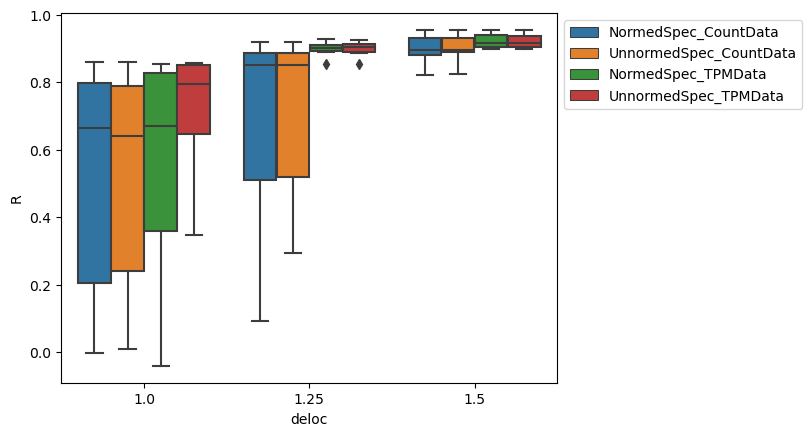

In [82]:
ind = allres['GEP'].isin(['Activity_1', 'Activity_2'])
ax = sns.boxplot(x='deloc', y='R', hue='Condition', data=allres.loc[ind,:], dodge=True)
ax.legend(bbox_to_anchor=(1,1))

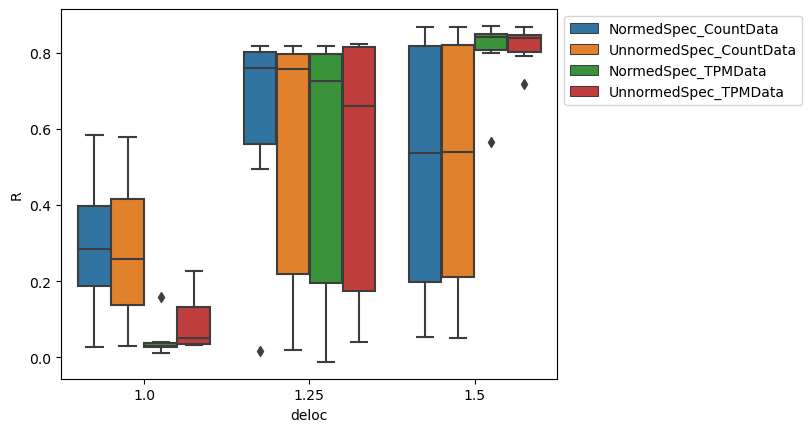

In [83]:
ind = allres['GEP'].isin(['Activity_3', 'Activity_4'])
ax = sns.boxplot(x='deloc', y='R', hue='Condition', data=allres.loc[ind,:], dodge=True)
ax.legend(bbox_to_anchor=(1,1))

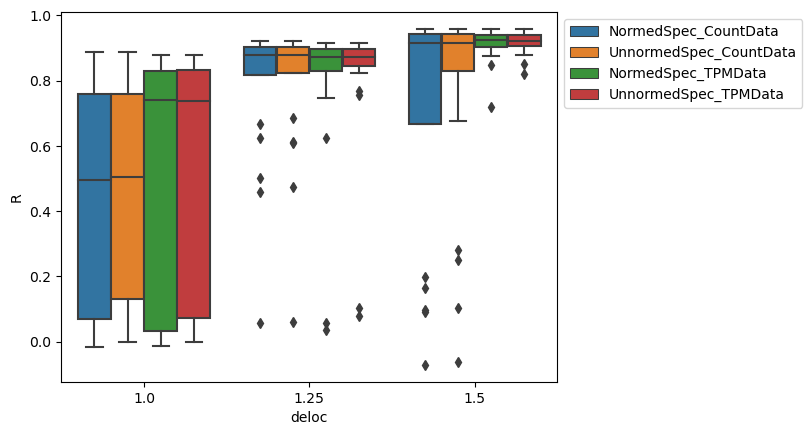

In [84]:
ind = ~allres['GEP'].isin(['Activity_1', 'Activity_2', 'Activity_3', 'Activity_4'])
ax = sns.boxplot(x='deloc', y='R', hue='Condition', data=allres.loc[ind,:], dodge=True)
ax.legend(bbox_to_anchor=(1,1))

In [ ]:
deprob = [.025]*7 + [.05]*2 + [.025]*2
deloc = [1.5]*7 + [2.00]*2 + [1.5]*2
simmod_catalog_libvar = SCsim_DiffScale(seed=47)
simmod_catalog_libvar.simulate(ncells=10000, ngenes=10000, nidentities=7, activity_pct=[.3]*4,
                activity_min=[.1]*4, activity_max=[.7]*4,
                activity_identities=[list(range(1,8))]*4,
                pct_doublets=.05, diffexploc=deloc, diffexpscale=1, diffexpprob=deprob,
                delta_range_libloc=.15)

In [ ]:
simmod_catalog_libvar.spectra.sum(axis=1)

In [ ]:
from scipy.stats import pearsonr
libsize = simmod_catalog_libvar.counts.sum(axis=1)

(fig,axes) = plt.subplots(2, 6, figsize=(10,4), dpi=200)
axes[0,0].set_ylabel('Library Size')
axes[1,0].set_ylabel('Library Size')
plt.figtext(.53, 0, 'GEP usage', va='bottom', ha='center')
axes = axes.ravel()

for (i,a) in enumerate(axes):
    if i > 10:
        break
    a.scatter(simmod_catalog_libvar.usage.iloc[:,i], libsize, s=2)
    R,P = pearsonr(simmod_catalog_libvar.usage.iloc[:,i], libsize)
    a.set_title(simmod_catalog_libvar.usage.columns[i] + '\nR=%.2f' % R, fontsize=10)
    
plt.tight_layout()

In [ ]:
adatas = []
umaps = []
identity_map = dict(zip(np.arange(1,8), sns.color_palette("tab10")))
strmap = {'Ref1 - Sim2':'Identity:1,2,3,4,5,6\nActivity:1,2,3', 'Ref2 - Sim2':'Identity:2,3,4,5,6,7\nActivity:2,3,4', 'Query - Sim2':'Identity:1,2,3,4,7\nActivity:1,2'}


for (data, label) in [(simmod_catalog_libvar, 'Catalog_Libvar')]:
    a = sc.AnnData(X=data.counts, obs=data.usage, var=data.geneparams)
    a = process(a)
    adatas.append(a)


    umap = pd.DataFrame(a.obsm['X_umap'], index=a.obs.index, columns=['U1', 'U2'])
    umap['identity'] = data.cellparams['Identity']
    umap['color'] = umap['identity'].apply(lambda x: identity_map[x])
    umaps.append(umap)


    (fig,ax) = plt.subplots(1,1, figsize=(3,3), dpi=200)
    ax.scatter(umap['U1'], umap['U2'], c=umap['color'], s=.5)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(label)
    ax.text(.5,-0.1,label, ha='center', va='center', transform=ax.transAxes)

In [ ]:
a.obs['log_counts'] = a.obs['n_counts'].apply(np.log10)

In [ ]:
sc.pl.umap(a, color=a.obs.columns)

In [ ]:
sc.pl.umap(a, color=a.var.sort_values(by='Identity_1.DEratio', ascending=False).index[:4], vmax='p99')

In [ ]:
sc.pl.umap(a, color=a.var.sort_values(by='Activity_1.DEratio', ascending=False).index[:4], vmax='p99')

In [ ]:
sc.pl.umap(a, color=a.var.sort_values(by='Activity_2.DEratio', ascending=False).index[:4], vmax='p99')

In [ ]:
sc.pl.umap(a, color=a.var.sort_values(by='Activity_3.DEratio', ascending=False).index[:4], vmax='p99')

In [ ]:
sc.pl.umap(a, color=a.var.sort_values(by='Activity_4.DEratio', ascending=False).index[:4], vmax='p99', vmin=0)

In [ ]:
kmap = {'Catalog_Norm_VariableGEPMagnitue_Libvar':11, 'Catalog_NoNorm_VariableGEPMagnitue_Libvar':11}

In [ ]:

all_results = {}
for (data, label) in [(simmod_catalog_libvar, 'Catalog_Norm_VariableGEPMagnitue_Libvar')]:
    a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()
    sc.pp.filter_genes(a, min_cells=5)
    countfn = '{d}/{lab}.counts.h5ad'.format(d=datadir, lab=label)
    sc.write(countfn, a)
    data.geneparams.to_csv('{d}/{lab}.geneparams.tsv'.format(d=datadir, lab=label), sep='\t')
    cnmf_obj = cNMF(output_dir=datadir, name=label)
    cnmf_obj.prepare(counts_fn=countfn, components=kmap[label], n_iter=20, seed=14, num_highvar_genes=1000)
    cnmf_obj.factorize()
    cnmf_obj.combine()
    cnmf_obj.consensus(k=kmap[label], density_threshold=0.07, show_clustering=True, refit_usage=True, normalize_tpm_spectra=True)
    
    X = pd.DataFrame(a.X, index=a.obs.index, columns=a.var.index)
    res = load_and_relabel(cnmf_obj, X, data.spectra, K=kmap[label], ldthresh=0.07)
    all_results[label] = res.copy()
    

In [ ]:
for (data, label) in [(simmod_catalog_libvar, 'Catalog_NoNorm_VariableGEPMagnitue_Libvar')]:
    a = sc.AnnData(X=data.counts, obs=data.usage, var=data.spectra.T).copy()
    sc.pp.filter_genes(a, min_cells=5)
    countfn = '{d}/{lab}.counts.h5ad'.format(d=datadir, lab=label)
    sc.write(countfn, a)
    data.geneparams.to_csv('{d}/{lab}.geneparams.tsv'.format(d=datadir, lab=label), sep='\t')
    cnmf_obj = cNMF(output_dir=datadir, name=label)
    cnmf_obj.prepare(counts_fn=countfn, components=kmap[label], n_iter=20, seed=14, num_highvar_genes=1000)
    cnmf_obj.factorize()
    cnmf_obj.combine()
    cnmf_obj.consensus(k=kmap[label], density_threshold=0.07, show_clustering=True, refit_usage=True, normalize_tpm_spectra=False)
    
    X = pd.DataFrame(a.X, index=a.obs.index, columns=a.var.index)
    res = load_and_relabel(cnmf_obj, X, data.spectra, K=kmap[label], ldthresh=0.07)
    all_results[label] = res.copy()
    

In [ ]:
R = df_col_corr(all_results['Catalog_Norm_VariableGEPMagnitue_Libvar']['usage'], simmod_catalog_libvar.usage.sort_index(axis=1))
(fig,ax) = plt.subplots(1,1, figsize=(5,5), dpi=200)
sns.heatmap(R, ax=ax, annot=True, fmt='.2f', annot_kws={'fontsize':5},)

In [ ]:
R

In [ ]:
R = df_col_corr(all_results['Catalog_NoNorm_VariableGEPMagnitue_Libvar']['usage'], simmod_catalog_libvar.usage.sort_index(axis=1))
(fig,ax) = plt.subplots(1,1, figsize=(5,5), dpi=200)
sns.heatmap(R, ax=ax, annot=True, fmt='.2f', annot_kws={'fontsize':5},)

In [ ]:
R

In [ ]:
all_results['Catalog_NoNorm_VariableGEPMagnitue_Libvar']['tpm'].sum(axis=1)

In [ ]:
all_results['Catalog_Norm_VariableGEPMagnitue_Libvar']['tpm'].sum(axis=1)

In [ ]:
from scipy.stats import pearsonr
libsize = simmod_catalog_libvar.counts.sum(axis=1)

(fig,axes) = plt.subplots(2, 6, figsize=(10,4), dpi=200)
axes[0,0].set_ylabel('Norm usage')
axes[1,0].set_ylabel('Norm usage')
plt.figtext(.53, 0, 'No norm usage', va='bottom', ha='center')
axes = axes.ravel()

for (i,a) in enumerate(axes):
    if i > 10:
        break
    a.scatter(all_results['Catalog_NoNorm_VariableGEPMagnitue_Libvar']['usage'].iloc[:,i], all_results['Catalog_Norm_VariableGEPMagnitue_Libvar']['usage'].iloc[:,i], s=2)
    R,P = pearsonr(all_results['Catalog_NoNorm_VariableGEPMagnitue_Libvar']['usage'].iloc[:,i], all_results['Catalog_Norm_VariableGEPMagnitue_Libvar']['usage'].iloc[:,i])
    a.set_title(simmod_catalog.usage.columns[i] + '\nR=%.5e' % R, fontsize=10)
    
plt.tight_layout()

In [ ]:
tpm_spectra = all_results['Catalog_NoNorm_VariableGEPMagnitue_Libvar']['tpm']
multipliers = 1e6/tpm_spectra.sum(axis=1)
tpm_spectra_norm = tpm_spectra.multiply(multipliers, axis=0)

In [ ]:
import scipy.sparse as sp
def load_df_from_npz(filename):
    with np.load(filename, allow_pickle=True) as f:
        obj = pd.DataFrame(**f)
    return obj

label = 'Catalog_NoNorm_VariableGEPMagnitue_Libvar'
cnmf_obj = cNMF(output_dir=datadir, name=label)
tpm_stats = load_df_from_npz(cnmf_obj.paths['tpm_stats'])
hvgs = open(cnmf_obj.paths['nmf_genes_list']).read().split('\n')
tpm = sc.read(cnmf_obj.paths['tpm'])
norm_tpm = tpm[:, hvgs]
if sp.issparse(norm_tpm.X):
    sc.pp.scale(norm_tpm, zero_center=False)                       
else:
    norm_tpm.X /= norm_tpm.X.std(axis=0, ddof=1)
                
spectra_tpm_rf = tpm_spectra.loc[:,hvgs]
spectra_tpm_rf = spectra_tpm_rf.div(tpm_stats.loc[hvgs, '__std'], axis=1)

spectra_tpm_rf_norm = tpm_spectra_norm.loc[:,hvgs]
spectra_tpm_rf_norm = spectra_tpm_rf_norm.div(tpm_stats.loc[hvgs, '__std'], axis=1)

In [ ]:
rf_usages = cnmf_obj.refit_usage(norm_tpm.X, spectra_tpm_rf.astype(np.float32))
rf_usages = pd.DataFrame(rf_usages, index=norm_tpm.obs.index, columns=spectra_tpm_rf.index) 

In [ ]:
rf_usages_norm = cnmf_obj.refit_usage(norm_tpm.X, spectra_tpm_rf_norm.astype(np.float32))
rf_usages_norm = pd.DataFrame(rf_usages_norm, index=norm_tpm.obs.index, columns=spectra_tpm_rf_norm.index) 

In [ ]:
rf_usages.head()

In [ ]:
rf_usages_norm.head()

In [ ]:
rf_usages2 = rf_usages.div(rf_usages.sum(axis=1), axis=0)
rf_usages_norm2 = rf_usages_norm.div(rf_usages_norm.sum(axis=1), axis=0)

In [ ]:
rf_usages2.head()

In [ ]:
rf_usages_norm2.head()

In [ ]:
rf_usages_norm2 / rf_usages2

In [ ]:
spectra_tpm_rf.sum(axis=1)

In [ ]:
spectra_tpm_rf_norm.sum(axis=1)

In [ ]:
spectra_tpm_rf

In [ ]:
spectra_tpm_rf_norm

In [ ]:
multipliers

In [ ]:
spectra_tpm_rf_norm

In [ ]:
rf_usages_norm.sum().sum()

In [ ]:
rf_usages.sum().sum()

In [ ]:
rf_usages.head()

In [ ]:
rf_usages_norm.multiply(multipliers, axis=1).head()

In [ ]:
rf_usages_norm.head()